#    <center> <h1>Projet IA: Smart City</h1> </center>
    
    
    
    
  

In [1]:
from jyquickhelper import add_notebook_menu
add_notebook_menu()

## Importation des librairies 

In [2]:
import pandas as pd              
import numpy as np               
import seaborn as sns            
import matplotlib.pyplot as plt  
%matplotlib inline
import scipy
import bs4
from bs4 import BeautifulSoup
import requests
from datetime import datetime
import re
from matplotlib import rcParams
from pandas_profiling import ProfileReport


## Scrapping Emission Greenhouse Gases CO2 de 36 pays

Sources: https://stats.oecd.org/Index.aspx?DataSetCode=AIR_GHG

In [3]:
#pip install beautifulsoup4

In [4]:
url= 'https://stats.oecd.org/Index.aspx?DataSetCode=AIR_GHG'
page = requests.get(url)
soup =  BeautifulSoup(page.content,'html.parser')
response = requests.get(url)
html = BeautifulSoup(response.text, 'html.parser')
conteneur = html.find('table', class_="DataTable")
tr=conteneur.find_all('td')
raw=[]
for i in conteneur.find_all('td'):
    a=i.text
    raw.append(a.replace('\xa0', ''))

In [5]:
n2010=[]
n2011=[]
n2012=[]
n2013=[]
n2014=[]
n2015=[]
n2016=[]
n2017=[]
n2018=[]
n2019=[]
country=[]

for i in range(0,37):
    z10=22+32*i
    z11=23+32*i
    z12=24+32*i
    z13=25+32*i
    z14=26+32*i
    z15=27+32*i
    z16=28+32*i
    z17=29+32*i
    z18=30+32*i
    z19=31+32*i
    z20=0+32*i
    x10=raw[z10]
    x11=raw[z11]
    x12=raw[z12]
    x13=raw[z13]
    x14=raw[z14]
    x15=raw[z15]
    x16=raw[z16]
    x17=raw[z17]
    x18=raw[z18]
    x19=raw[z19]
    x20=raw[z20]
    n2010.append(x10)
    n2011.append(x11)
    n2012.append(x12)
    n2013.append(x13)
    n2014.append(x14)
    n2015.append(x15)
    n2016.append(x16)
    n2017.append(x17)
    n2018.append(x18)
    n2019.append(x19)
    country.append(x20)

In [6]:
year=[]
for i in range(2010,2020):
    year.append(i)
year

[2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019]

In [7]:
df = pd.DataFrame(columns=year)
df=df.transpose()
dict_1 = {'country':country, '2010': n2010,
          '2011': n2011,'2012': n2012,
          '2013': n2013,'2014': n2014,
          '2015': n2015,'2016': n2016,
          '2017': n2017,'2018': n2018,
          '2019': n2019, }
df = pd.DataFrame.from_dict(dict_1, orient='index')

dt = df.transpose()

df=dt.replace('..','NaN')
df.head(5)

,country,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019
0,Australia,535549.22,537205.50,539511.06,530311.91,524709.40,533063.83,542287.87,549330.02,549731.94,545152.52
1,Austria,84336.72,82127.03,79432.38,79817.17,76238.67,78462.23,79471.01,81862.50,78627.64,79842.25
2,Belgium,133633.52,123134.28,120385.71,120443.49,114732.00,118959.98,117689.18,117424.30,117894.74,116651.49
3,Canada,702802.75,714078.51,717172.39,725371.84,722557.67,723096.02,706933.91,716092.01,728475.89,730244.94
4,Chile,87942.08,96508.95,102424.84,102678.36,99268.13,106342.22,110156.04,111215.64,112312.62,NaN


### Analyse des chiffres par Année

In [8]:
year1=[]
for i in range(2010,2020):
    year1.append(str(i))

In [9]:
for i in year1:
    df[i]=df[i].astype(float)
df.describe().round(2)
#On peut observé que la moyenne entre 2010 et 2013 est plus élevé que les années suivantes, une tendence positive de la réduction d'émission peut être observée

,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019
count,37.00,37.00,37.00,37.00,37.00,36.00,35.00,35.00,34.00,31.00
mean,252524.77,251698.32,252669.55,251156.25,245038.55,248662.02,235427.59,236959.30,240426.30,227108.20
std,308044.14,312353.33,317480.69,319351.31,310529.33,311722.06,304385.12,303993.36,300158.69,291131.98
min,4866.27,4647.06,4657.36,4654.39,4685.66,4763.99,4716.62,4795.42,4822.19,4722.35
25%,55265.59,54509.57,53998.11,53989.10,52332.15,49407.14,50236.71,48758.90,50258.53,45960.18
50%,84336.72,82127.03,83789.44,79827.77,80674.00,79925.11,78984.71,80282.00,79602.98,79842.25
75%,413501.55,428120.39,447582.09,439694.38,427930.41,446378.94,419058.69,423766.57,424375.06,404512.64
max,1300451.71,1351251.66,1394043.99,1405888.61,1356588.54,1318516.70,1301855.89,1288528.72,1245020.89,1209493.35


/Users/jade/opt/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


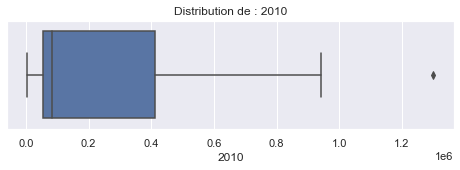

/Users/jade/opt/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


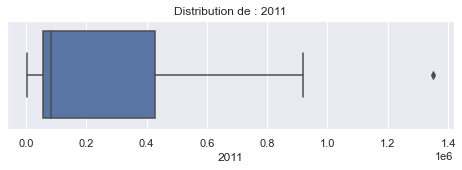

/Users/jade/opt/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


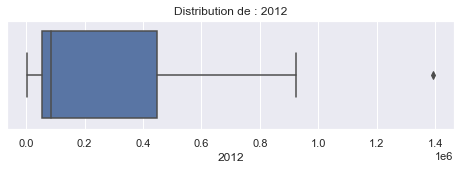

/Users/jade/opt/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


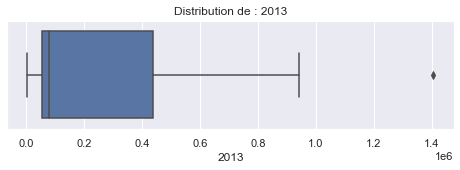

/Users/jade/opt/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


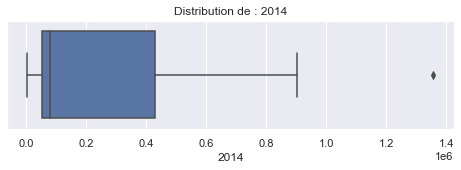

/Users/jade/opt/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


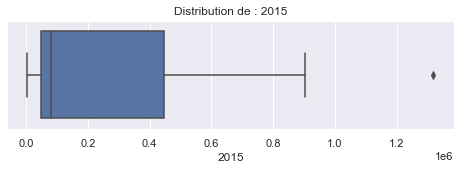

/Users/jade/opt/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


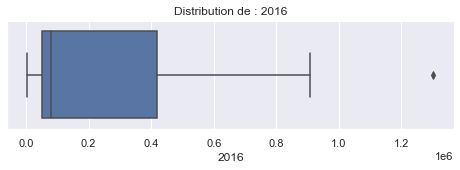

/Users/jade/opt/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


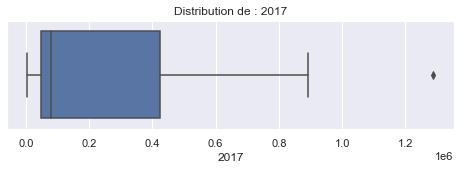

/Users/jade/opt/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


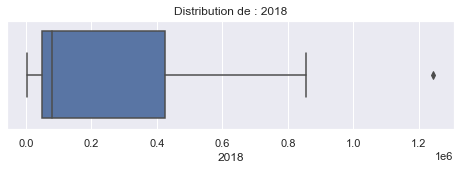

/Users/jade/opt/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


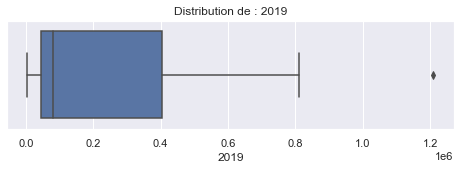

In [10]:
sns.set(font_scale=1)
for column in year1:
    plt.figure(figsize = (8,2))
    
    sns.boxplot(df[column])
    chaine = 'Distribution de : ' + column
    plt.title(chaine)
    plt.xlabel(column)
    plt.show()
sns.set(font_scale=1)
#On peut voir la distribution des données de chaque année

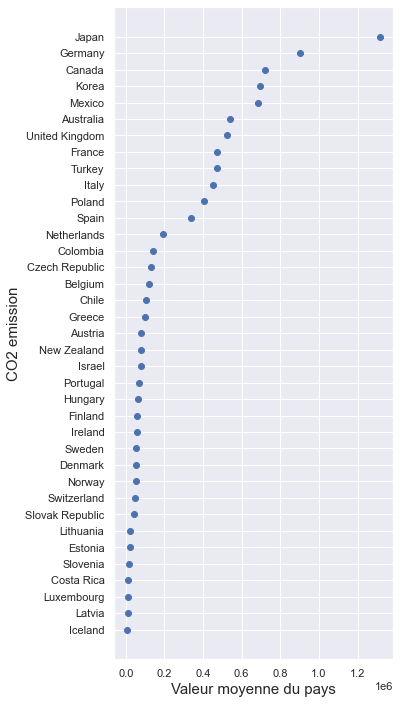

In [11]:
dfaverage=df
dfaverage['average']=df.mean(numeric_only=True, axis=1).round(2)
dfaverage=dfaverage.sort_values(by='average',ascending=True)
x = dfaverage['average']
y = dfaverage['country']
plt.figure(figsize=(5, 12))
plt.xlabel("Valeur moyenne du pays", fontsize=15)
plt.ylabel("CO2 emission", fontsize=15)

plt.scatter(x, y)
#les 5 pays les plus polluants sont Japon, Allemagne, Canada, Corée et Mexique

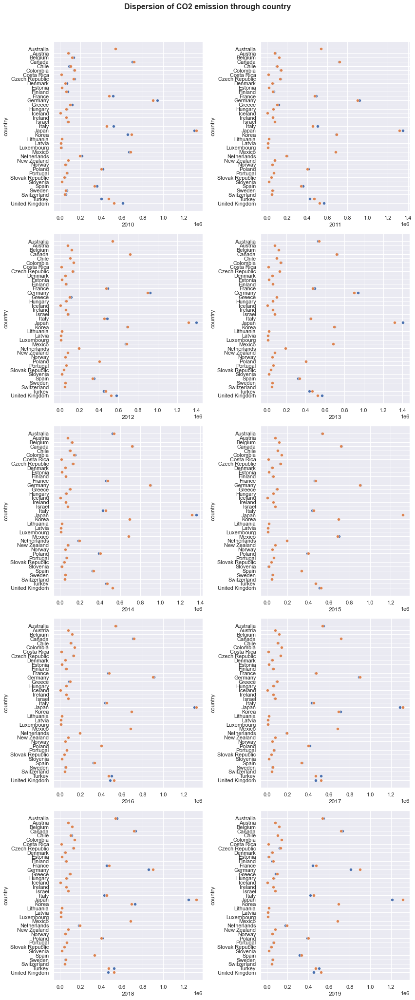

In [12]:
fig = plt.figure(figsize=(12,30))
with sns.color_palette():
    for i, c in enumerate(year1,1):
        ax = fig.add_subplot(5,2,i)
        col="country"
        sns.scatterplot(data=df, y=col, x=c)
        sns.scatterplot(data=df, y=col, x='average')

plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.suptitle('Dispersion of CO2 emission through country', fontsize=16,
             fontweight='bold')

plt.show()
#Plus de détail en émission par an, le point orange est la moyenne et le point blue l'émission de chaque pays

#  Emission par pays

In [13]:
df_text=df.set_index('country')
df_country=df_text.transpose()
countryname=[]
for i in df['country']:
    countryname.append(i)
europe=['Austria', 'Belgium', 'Bulgaria', 'Croatia', 'Republic of Cyprus', 'Czech Republic', 
        'Denmark', 'Estonia', 'Finland', 'France', 'Germany', 'Greece', 'Hungary', 
        'Ireland', 'Italy', 'Latvia', 'Lithuania', 'Luxembourg', 'Malta', 
        'Netherlands', 'Poland', 'Portugal', 'Romania', 'Slovakia', 'Slovenia', 
        'Spain', 'Sweden']
Europe=list(set(countryname).intersection(europe))
df_country['year']=df_country.index
df_country.head(10)

country,Australia,Austria,Belgium,Canada,Chile,Colombia,Costa Rica,Czech Republic,Denmark,Estonia,...,Poland,Portugal,Slovak Republic,Slovenia,Spain,Sweden,Switzerland,Turkey,United Kingdom,year
2010,535549.22,84336.72,133633.52,702802.75,87942.08,138247.79,12895.96,139605.90,64664.11,21218.19,...,413501.55,68727.03,45363.93,19613.54,357876.02,64557.43,54721.38,399143.06,608732.30,2010
2011,537205.50,82127.03,123134.28,714078.51,96508.95,133918.32,13284.87,138068.89,59429.58,21286.17,...,412488.95,67319.09,44555.47,19540.39,357588.45,60230.62,50606.40,428120.39,563659.98,2011
2012,539511.06,79432.38,120385.71,717172.39,102424.84,139838.47,13405.56,134138.67,54837.68,20114.88,...,404975.67,65404.63,42309.22,18917.61,350317.74,57376.45,51946.23,447582.09,580418.64,2012
2013,530311.91,79817.17,120443.49,725371.84,102678.36,147802.85,13735.74,128691.89,56560.81,22019.84,...,401638.24,63542.23,41862.56,18220.97,323525.94,55718.95,52831.53,439694.38,566545.83,2013
2014,524709.40,76238.67,114732.00,722557.67,99268.13,150614.76,13850.14,126563.24,52332.15,21176.38,...,388929.07,63439.83,39862.99,16581.50,325609.36,53833.30,48875.41,458953.88,526556.30,2014
2015,533063.83,78462.23,118959.98,723096.02,106342.22,NaN,13603.64,127972.21,49737.65,18139.32,...,390815.88,67586.67,40712.46,16760.95,336994.88,53998.52,48415.62,473335.82,509050.72,2015
2016,542287.87,79471.01,117689.18,706933.91,110156.04,NaN,14234.46,129584.95,51764.36,19808.93,...,400421.28,65741.58,41112.12,17616.46,325465.70,53571.52,48709.06,498886.78,484146.20,2016
2017,549330.02,81862.50,117424.30,716092.01,111215.64,NaN,14477.60,130460.08,49648.88,21066.44,...,414819.41,70790.72,42226.70,17696.60,338738.17,53010.59,47868.93,524980.92,473389.98,2017
2018,549731.94,78627.64,117894.74,728475.89,112312.62,NaN,NaN,128554.62,49621.30,20206.36,...,411852.17,67131.79,42159.13,17521.74,333250.41,52170.22,46369.71,522476.63,466666.98,2018
2019,545152.52,79842.25,116651.49,730244.94,NaN,NaN,NaN,122638.51,45812.18,14699.12,...,390744.67,63469.98,39948.33,17065.45,314528.51,50919.87,46108.19,506080.42,453101.46,2019


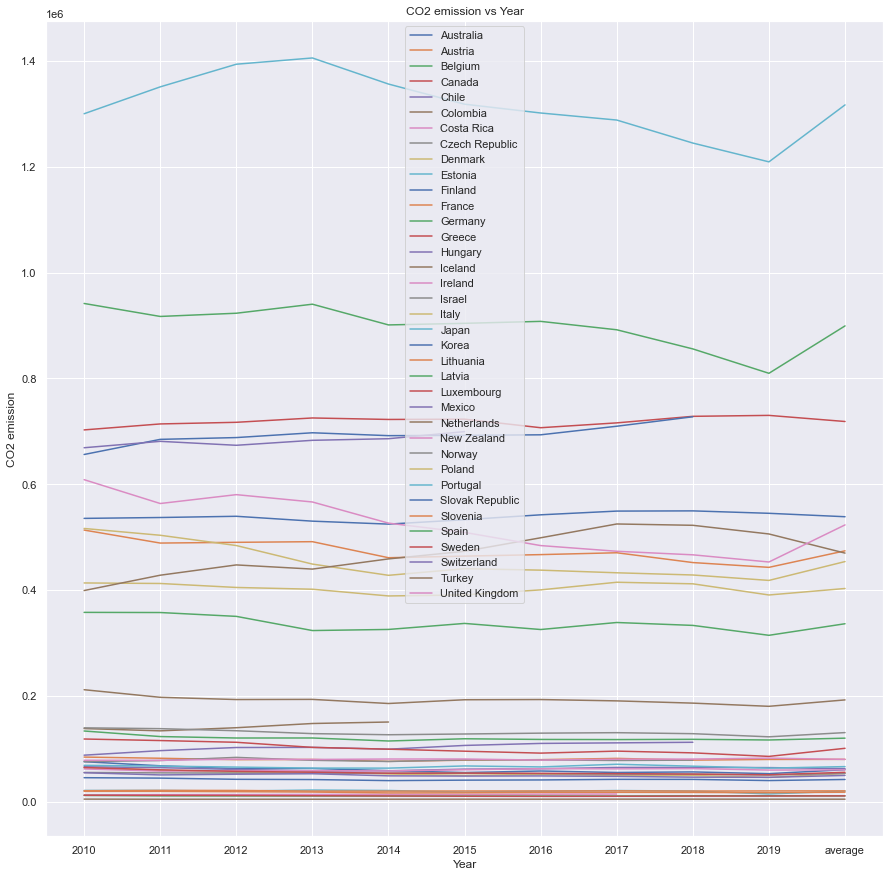

In [14]:
labels = []
fig = plt.figure(figsize=(15,15))
for a in countryname:
    plt.plot(df_country['year'],df_country[a])
    labels.append(a)
plt.legend(labels)
plt.title('CO2 emission vs Year')
plt.xlabel('Year')
plt.ylabel('CO2 emission')

plt.show()
#On peut constater que le Japon et l'Allemagne ont un taux d'émission bien supérieur que le reste du pays

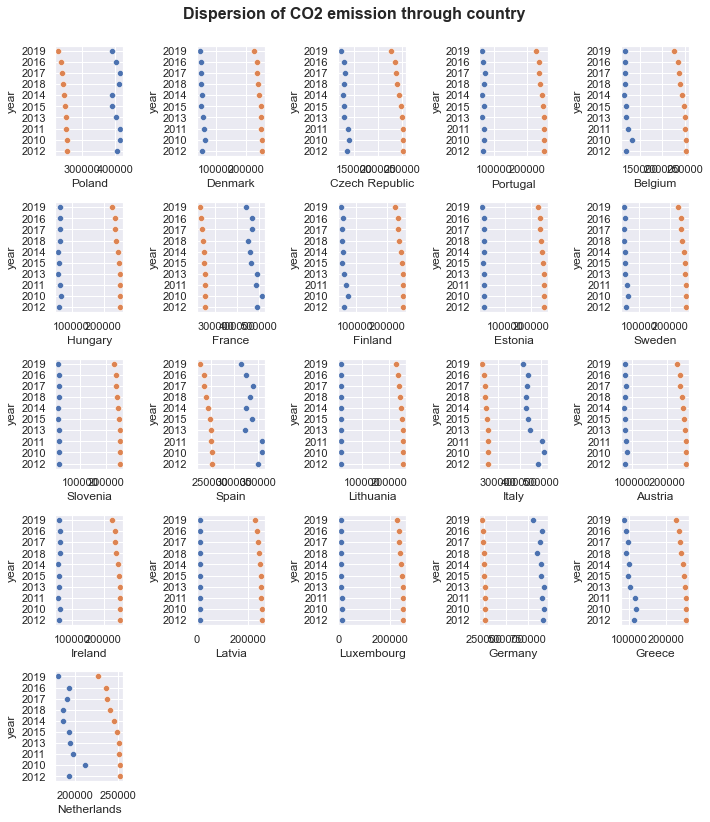

In [15]:
df_new=df_country
df_new['average']=df_new.mean(numeric_only=True, axis=1).round(2)
df_new.reset_index(drop=True)
df_new['year']=df_new.index
df_new=df_new.drop(df_new.index[10])
df_new=df_new.sort_values(by='average',ascending=True)

fig = plt.figure(figsize=(10,12))
with sns.color_palette():
    for i, c in enumerate(Europe,1):
        ax = fig.add_subplot(5,5,i)
        col="year"
        sns.scatterplot(data=df_new, y=col, x=c)
        sns.scatterplot(data=df_new, y=col, x='average')

plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.suptitle('Dispersion of CO2 emission through country', fontsize=16,
             fontweight='bold')

plt.show()
#Pour chaque pays, on peut voir son emission par rapport a la moyenne

<AxesSubplot:>

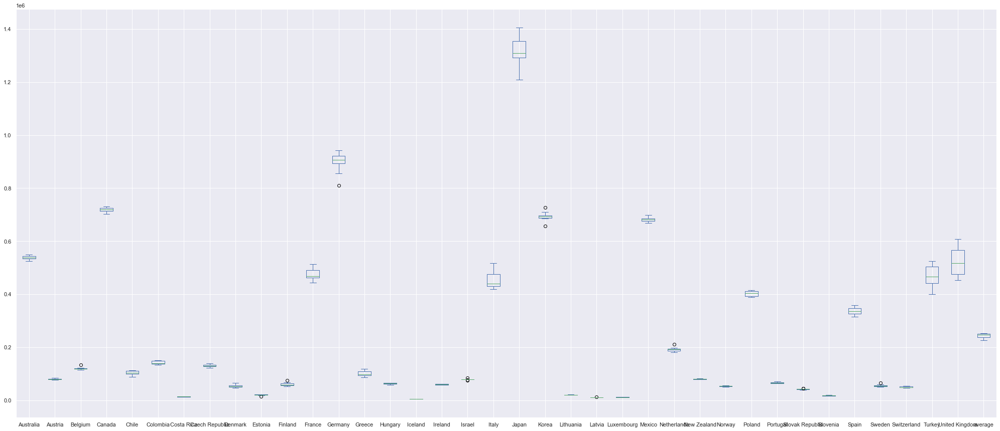

In [16]:
df_new.plot(kind="box", figsize=(35,15))
#Cette différence en termes d'émission peut être observé via ce boxplot

### Analyse plus en detail pour les pays europeens et la France

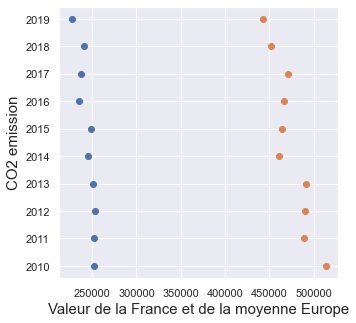

In [17]:
df_Europe=df_new[['year','average','Sweden',
 'Hungary','Lithuania','Italy',
 'Denmark','Luxembourg','Latvia',
 'Portugal','Austria','Spain',
 'Finland','France','Poland',
 'Slovenia','Czech Republic','Greece',
 'Germany','Netherlands','Belgium',
 'Estonia','Ireland']]

df_europe1=df_Europe.sort_values(by='year')
x = df_europe1['average']
y = df_europe1['year']
z = df_europe1['France']
plt.figure(figsize=(5, 5))
plt.xlabel("Valeur de la France et de la moyenne Europe", fontsize=15)
plt.ylabel("CO2 emission", fontsize=15)

plt.scatter(x, y)
plt.scatter(z, y)
#On peut voir que la France(orange) a fait des efforts pour réduire son émission mais la valeur est toujours supérieure que la moyenne 


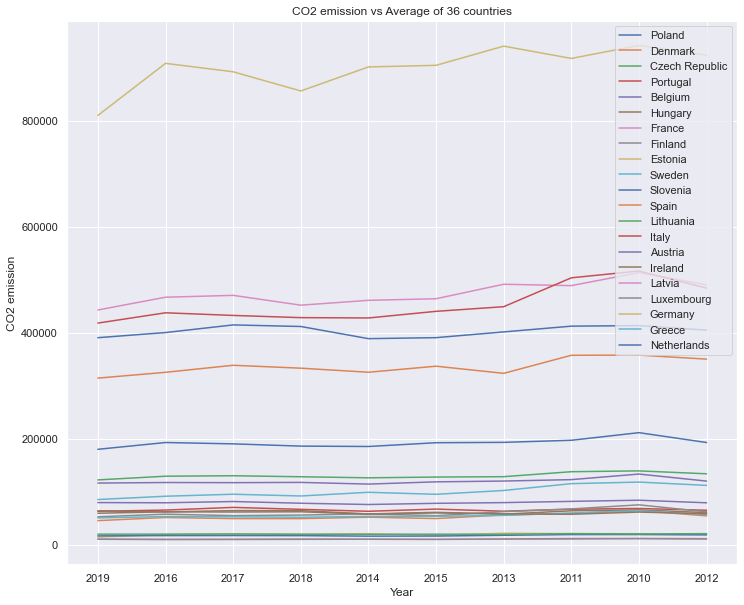

In [18]:
labels=[]
fig = plt.figure(figsize=(12,10))
for a in Europe:
    plt.plot(df_Europe['year'],df_new[a])
    labels.append(a)
plt.legend(labels)
plt.title('CO2 emission vs Average of 36 countries')
plt.xlabel('Year')
plt.ylabel('CO2 emission')

plt.show()
#On peut voir que les top 3 pays polluants sont Allemagne, France et Italie

In [19]:
df_Europe.sort_values(by=['average'],ascending=False)
#Et les top 5 années ou l'Europe est le plus polluant en terme de emission CO2. 
#Avant 2015, l'Europe a été très polluant mais on peut observer un effort a partir de 2016

country,year,average,Sweden,Hungary,Lithuania,Italy,Denmark,Luxembourg,Latvia,Portugal,...,France,Poland,Slovenia,Czech Republic,Greece,Germany,Netherlands,Belgium,Estonia,Ireland
2012,2012,252669.55,57376.45,60957.51,21261.46,484218.02,54837.68,11807.44,10851.36,65404.63,...,490286.17,404975.67,18917.61,134138.67,112305.52,923342.03,193081.48,120385.71,20114.88,58785.14
2010,2010,252524.77,64557.43,66056.58,20742.36,516473.73,64664.11,12176.42,11820.12,68727.03,...,513461.78,413501.55,19613.54,139605.90,118500.04,941805.34,211675.15,133633.52,21218.19,61949.41
2011,2011,251698.32,60230.62,64354.14,21338.66,503645.26,59429.58,12052.77,11029.89,67319.09,...,488902.16,412488.95,19540.39,138068.89,115571.73,917273.60,197327.07,123134.28,21286.17,57793.58
2013,2013,251156.25,55718.95,58068.18,20024.00,449178.94,56560.81,11270.40,10763.41,63542.23,...,491502.99,401638.24,18220.97,128691.89,102684.38,940419.54,193387.53,120443.49,22019.84,58570.58
2015,2015,248662.02,53998.52,61516.67,20283.04,440436.70,49737.65,10324.43,10724.86,67586.67,...,464205.67,390815.88,16760.95,127972.21,95463.98,904261.81,192712.73,118959.98,18139.32,60431.95
2014,2014,245038.55,53833.30,58407.72,19986.69,427930.41,52332.15,10807.26,10671.01,63439.83,...,461188.53,388929.07,16581.50,126563.24,99257.81,901255.14,185617.27,114732.00,21176.38,58062.57
2018,2018,240426.30,52170.22,64735.40,20150.10,428549.35,49621.30,10565.23,11260.72,67131.79,...,452034.46,411852.17,17521.74,128554.62,92308.35,855890.41,186318.55,117894.74,20206.36,62526.01
2017,2017,236959.30,53010.59,64716.42,20518.88,432713.74,49648.88,10266.98,10757.14,70790.72,...,470564.32,414819.41,17696.60,130460.08,95600.99,892075.67,190567.47,117424.30,21066.44,62114.86
2016,2016,235427.59,53571.52,62258.59,20311.83,437696.09,51764.36,10082.90,10716.53,65741.58,...,467060.00,400421.28,17616.46,129584.95,91821.84,907967.91,193101.02,117689.18,19808.93,62475.14
2019,2019,227108.20,50919.87,64433.17,20367.85,418280.60,45812.18,10742.80,11132.14,63469.98,...,442984.67,390744.67,17065.45,122638.51,85630.94,809798.54,180309.09,116651.49,14699.12,59777.64


In [20]:
df_Europe1=df_Europe.drop(['year', 'average'], axis=1).transpose()
df_Europe1['average']=df_Europe1.mean(numeric_only=True, axis=1).round(2)
df_Europe1.sort_values(by=['average'],ascending=False).head(10)
#On peut également constater que l'Allemagne, la France et l'Italie sont les 3 pays les plus polluants en terme de emission CO2

,2019,2016,2017,2018,2014,2015,2013,2011,2010,2012,average
country,,,,,,,,,,,
Germany,809798.54,907967.91,892075.67,855890.41,901255.14,904261.81,940419.54,917273.60,941805.34,923342.03,899409.00
France,442984.67,467060.00,470564.32,452034.46,461188.53,464205.67,491502.99,488902.16,513461.78,490286.17,474219.08
Italy,418280.60,437696.09,432713.74,428549.35,427930.41,440436.70,449178.94,503645.26,516473.73,484218.02,453912.28
Poland,390744.67,400421.28,414819.41,411852.17,388929.07,390815.88,401638.24,412488.95,413501.55,404975.67,403018.69
Spain,314528.51,325465.70,338738.17,333250.41,325609.36,336994.88,323525.94,357588.45,357876.02,350317.74,336389.52
Netherlands,180309.09,193101.02,190567.47,186318.55,185617.27,192712.73,193387.53,197327.07,211675.15,193081.48,192409.74
Czech Republic,122638.51,129584.95,130460.08,128554.62,126563.24,127972.21,128691.89,138068.89,139605.90,134138.67,130627.90
Belgium,116651.49,117689.18,117424.30,117894.74,114732.00,118959.98,120443.49,123134.28,133633.52,120385.71,120094.87
Greece,85630.94,91821.84,95600.99,92308.35,99257.81,95463.98,102684.38,115571.73,118500.04,112305.52,100914.56


## Open set : https://www.data.gouv.fr/fr/datasets/respirons-mieux-dans-le-20eme-donnees-mini-stations/

In [21]:
data_brute=pd.read_csv("respirons-mieux-dans-le-20eme-donnees-mini-stations (1).csv", sep=';')

In [22]:
data_brute.head()

,index,Date et heure de la mesure,Père Lachaise,Parc de Belleville,Bd Ménilmontant,Stade Louis Lumière,Rue Ménilmontant,Rue des Pyrénées,Place St Fargeau,Echangeur A3/BP,Station Référence - BP Est,Station Référence - Paris 18ème
0,93,2019-01-04T21:00:00+01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,32.1,48.2
1,114,2019-01-05T18:00:00+01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,27.1,54.9
2,198,2019-01-09T06:00:00+01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,31.3,36.8
3,206,2019-01-09T14:00:00+01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,48.4,40.0
4,207,2019-01-09T15:00:00+01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,51.6,41.2


In [23]:
data=data_brute.copy()

In [24]:
data.head()

,index,Date et heure de la mesure,Père Lachaise,Parc de Belleville,Bd Ménilmontant,Stade Louis Lumière,Rue Ménilmontant,Rue des Pyrénées,Place St Fargeau,Echangeur A3/BP,Station Référence - BP Est,Station Référence - Paris 18ème
0,93,2019-01-04T21:00:00+01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,32.1,48.2
1,114,2019-01-05T18:00:00+01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,27.1,54.9
2,198,2019-01-09T06:00:00+01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,31.3,36.8
3,206,2019-01-09T14:00:00+01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,48.4,40.0
4,207,2019-01-09T15:00:00+01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,51.6,41.2


### Data cleaning

#### Modification Dataframe

In [25]:
del data["index"]

In [26]:
data.columns = ['date_et_heure_de_la_mesure','Pere_Lachaise','Parc_de_Belleville','Bd_Ménilmontant','Stade_Louis_Lumière','Rue_Ménilmontant','Rue_des_Pyrénées','Place_St_Fargeau','Echangeur_A3_BP','Station_Référence_BP_Est','Station_Référence_Paris_18ème']

In [27]:
data.head()

,date_et_heure_de_la_mesure,Pere_Lachaise,Parc_de_Belleville,Bd_Ménilmontant,Stade_Louis_Lumière,Rue_Ménilmontant,Rue_des_Pyrénées,Place_St_Fargeau,Echangeur_A3_BP,Station_Référence_BP_Est,Station_Référence_Paris_18ème
0,2019-01-04T21:00:00+01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,32.1,48.2
1,2019-01-05T18:00:00+01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,27.1,54.9
2,2019-01-09T06:00:00+01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,31.3,36.8
3,2019-01-09T14:00:00+01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,48.4,40.0
4,2019-01-09T15:00:00+01:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,51.6,41.2


In [28]:
data.insert(1, 'heure_de_la_mesure',data.mean(1))
data.insert(2, 'Month',data.mean(1))
data['heure_de_la_mesure']= data['date_et_heure_de_la_mesure'].str.slice(11, 19)
data['Month']=data['date_et_heure_de_la_mesure'].str.slice(0, 7)

/var/folders/b9/5kv9j4kn0mjgnpxsk1mvs2f80000gn/T/ipykernel_1334/2286504697.py:1: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  data.insert(1, 'heure_de_la_mesure',data.mean(1))
/var/folders/b9/5kv9j4kn0mjgnpxsk1mvs2f80000gn/T/ipykernel_1334/2286504697.py:2: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  data.insert(2, 'Month',data.mean(1))


In [29]:
data['date_et_heure_de_la_mesure'] = data['date_et_heure_de_la_mesure'].str.slice(0, 10)
data=data.rename(columns = {'date_et_heure_de_la_mesure':'date_de_la_mesure'})

In [30]:
data.set_index('date_de_la_mesure', inplace=True)

In [31]:
data.head()

,heure_de_la_mesure,Month,Pere_Lachaise,Parc_de_Belleville,Bd_Ménilmontant,Stade_Louis_Lumière,Rue_Ménilmontant,Rue_des_Pyrénées,Place_St_Fargeau,Echangeur_A3_BP,Station_Référence_BP_Est,Station_Référence_Paris_18ème
date_de_la_mesure,,,,,,,,,,,,
2019-01-04,21:00:00,2019-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,32.1,48.2
2019-01-05,18:00:00,2019-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,27.1,54.9
2019-01-09,06:00:00,2019-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,31.3,36.8
2019-01-09,14:00:00,2019-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,48.4,40.0
2019-01-09,15:00:00,2019-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,51.6,41.2


In [32]:
data.shape

(8760, 12)

<AxesSubplot:ylabel='Density'>

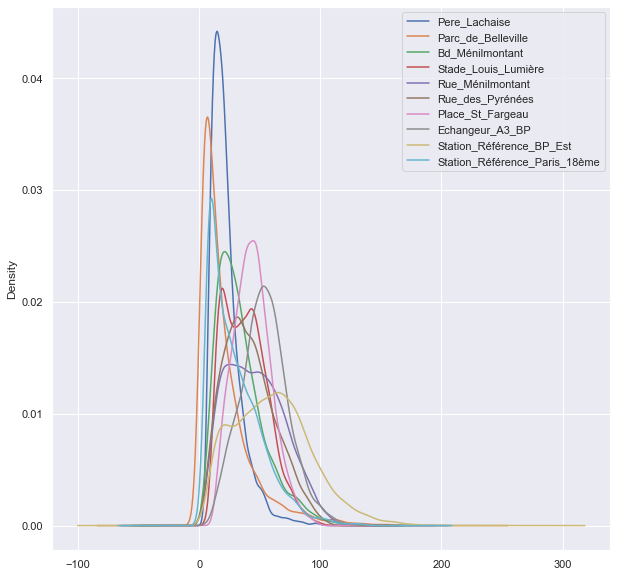

In [33]:
data.plot(kind='density',figsize=(10,10))

#### Données manquantes

Pour chaque station, calcul du pourcentage d'outliers afin de compléter la dataset soit par la moyenne soit par la médiane.

In [34]:
# Nombre de données manquantes par station
data.isna().sum(axis=0)

heure_de_la_mesure                  0
Month                               0
Pere_Lachaise                     933
Parc_de_Belleville               1806
Bd_Ménilmontant                  1343
Stade_Louis_Lumière               889
Rue_Ménilmontant                 1301
Rue_des_Pyrénées                  668
Place_St_Fargeau                 1308
Echangeur_A3_BP                   760
Station_Référence_BP_Est           60
Station_Référence_Paris_18ème     258
dtype: int64

In [35]:
# Pourcentage de données manquantes par station
data.isna().sum()/data.shape[0]*100

heure_de_la_mesure                0.000000
Month                             0.000000
Pere_Lachaise                    10.650685
Parc_de_Belleville               20.616438
Bd_Ménilmontant                  15.331050
Stade_Louis_Lumière              10.148402
Rue_Ménilmontant                 14.851598
Rue_des_Pyrénées                  7.625571
Place_St_Fargeau                 14.931507
Echangeur_A3_BP                   8.675799
Station_Référence_BP_Est          0.684932
Station_Référence_Paris_18ème     2.945205
dtype: float64

<AxesSubplot:>

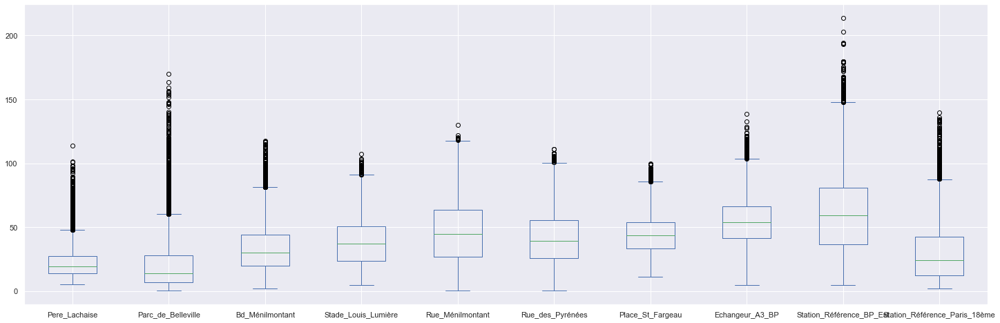

In [36]:
#plot pour avoir un aperçu des données outliers
data.plot(kind="box", figsize=(25,8))

In [37]:
# Nombre d'outliers par station 
Q1 = data.quantile(0.25) 
Q3 = data.quantile(0.75)
IQR = Q3 - Q1 
is_outliers = (data < (Q1 - 1.5 * IQR)) |(data > (Q3 + 1.5 * IQR))
is_outliers.sum()

/var/folders/b9/5kv9j4kn0mjgnpxsk1mvs2f80000gn/T/ipykernel_1334/223705657.py:5: FutureWarning: Automatic reindexing on DataFrame vs Series comparisons is deprecated and will raise ValueError in a future version. Do `left, right = left.align(right, axis=1, copy=False)` before e.g. `left == right`
  is_outliers = (data < (Q1 - 1.5 * IQR)) |(data > (Q3 + 1.5 * IQR))


Bd_Ménilmontant                  239
Echangeur_A3_BP                   90
Month                              0
Parc_de_Belleville               469
Pere_Lachaise                    382
Place_St_Fargeau                  67
Rue_Ménilmontant                   8
Rue_des_Pyrénées                  30
Stade_Louis_Lumière               35
Station_Référence_BP_Est          82
Station_Référence_Paris_18ème    172
heure_de_la_mesure                 0
dtype: int64

In [38]:
#taux d'outliers par station
taux_outliers=is_outliers.sum()/data.shape[0]*100 
round(taux_outliers, 2)

Bd_Ménilmontant                  2.73
Echangeur_A3_BP                  1.03
Month                            0.00
Parc_de_Belleville               5.35
Pere_Lachaise                    4.36
Place_St_Fargeau                 0.76
Rue_Ménilmontant                 0.09
Rue_des_Pyrénées                 0.34
Stade_Louis_Lumière              0.40
Station_Référence_BP_Est         0.94
Station_Référence_Paris_18ème    1.96
heure_de_la_mesure               0.00
dtype: float64

##### Station Parc_de_Belleville

In [39]:
median_Parc_de_Belleville = data.Parc_de_Belleville.median()
data.Parc_de_Belleville.fillna(median_Parc_de_Belleville, inplace=True)

##### Station Père_Lachaise

In [40]:
mean_Pere_Lachaise = data.Pere_Lachaise.mean()
data.Pere_Lachaise.fillna(mean_Pere_Lachaise, inplace=True)

##### Station Bd_Ménilmontant

In [41]:
mean_Bd_Ménilmontant = data.Bd_Ménilmontant.mean()
data.Bd_Ménilmontant.fillna(mean_Bd_Ménilmontant, inplace=True)

##### Station Stade_Louis_Lumière

In [42]:
mean_Stade_Louis_Lumière = data.Stade_Louis_Lumière.mean()
data.Stade_Louis_Lumière.fillna(mean_Stade_Louis_Lumière, inplace=True)

##### Station Rue_Ménilmontant

In [43]:
mean_Rue_Ménilmontant = data.Rue_Ménilmontant.mean()
data.Rue_Ménilmontant.fillna(mean_Rue_Ménilmontant, inplace=True)

##### Station Rue_des_Pyrénées

In [44]:
mean_Rue_des_Pyrénées = data.Rue_des_Pyrénées.mean()
data.Rue_des_Pyrénées.fillna(mean_Rue_des_Pyrénées, inplace=True)

##### Station Place_St_Fargeau

In [45]:
mean_Place_St_Fargeau = data.Place_St_Fargeau.mean()
data.Place_St_Fargeau.fillna(mean_Place_St_Fargeau, inplace=True)

##### Station Echangeur_A3_BP

In [46]:
mean_Echangeur_A3_BP = data.Echangeur_A3_BP.mean()
data.Echangeur_A3_BP.fillna(mean_Echangeur_A3_BP, inplace=True)

##### Station_Référence_BP_Est 

In [47]:
mean_Station_Référence_BP_Est = data.Station_Référence_BP_Est.median()
data.Station_Référence_BP_Est.fillna(mean_Station_Référence_BP_Est , inplace=True)

##### Station_Référence_Paris_18ème

In [48]:
mean_Station_Référence_Paris_18ème = data.Station_Référence_Paris_18ème.median()
data.Station_Référence_Paris_18ème.fillna(mean_Station_Référence_Paris_18ème, inplace=True)

In [49]:
data.isna().sum()

heure_de_la_mesure               0
Month                            0
Pere_Lachaise                    0
Parc_de_Belleville               0
Bd_Ménilmontant                  0
Stade_Louis_Lumière              0
Rue_Ménilmontant                 0
Rue_des_Pyrénées                 0
Place_St_Fargeau                 0
Echangeur_A3_BP                  0
Station_Référence_BP_Est         0
Station_Référence_Paris_18ème    0
dtype: int64

#### Données cumulées

Il n'y a aucune donnée cumulée.

In [50]:
data.duplicated().sum()

0

### Analyse univariée

In [51]:
Report_data = ProfileReport(data, title="Données mini stations Paris 20e", explorative=True)
#Report_data
Report_data.to_file("Données mini stations Paris 20e.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [52]:
data.describe().T.round(2)

,count,mean,std,min,25%,50%,75%,max
Pere_Lachaise,8760.0,22.48,12.12,5.28,14.35,20.87,26.14,113.78
Parc_de_Belleville,8760.0,19.97,20.43,0.48,8.14,13.93,23.26,169.96
Bd_Ménilmontant,8760.0,34.15,18.21,1.80,21.27,34.15,40.86,117.44
Stade_Louis_Lumière,8760.0,38.56,17.02,4.52,24.84,38.56,48.84,107.07
Rue_Ménilmontant,8760.0,46.41,21.87,0.03,29.88,46.41,59.87,130.01
Rue_des_Pyrénées,8760.0,41.69,20.17,0.05,26.75,41.62,53.83,110.97
Place_St_Fargeau,8760.0,44.15,14.24,11.03,35.06,44.15,51.72,99.98
Echangeur_A3_BP,8760.0,54.13,18.57,4.44,42.46,54.13,64.68,138.49
Station_Référence_BP_Est,8760.0,60.64,31.63,4.40,36.40,59.40,80.70,213.70
Station_Référence_Paris_18ème,8760.0,29.70,21.63,2.00,12.30,24.30,41.52,139.80


In [53]:
taux_de_dispersion=data.std()/data.mean()*100
taux_de_dispersion

/var/folders/b9/5kv9j4kn0mjgnpxsk1mvs2f80000gn/T/ipykernel_1334/1230058740.py:1: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  taux_de_dispersion=data.std()/data.mean()*100


Pere_Lachaise                     53.911707
Parc_de_Belleville               102.319895
Bd_Ménilmontant                   53.316790
Stade_Louis_Lumière               44.141608
Rue_Ménilmontant                  47.130528
Rue_des_Pyrénées                  48.378400
Place_St_Fargeau                  32.251854
Echangeur_A3_BP                   34.298946
Station_Référence_BP_Est          52.158045
Station_Référence_Paris_18ème     72.848052
dtype: float64

<AxesSubplot:ylabel='Frequency'>

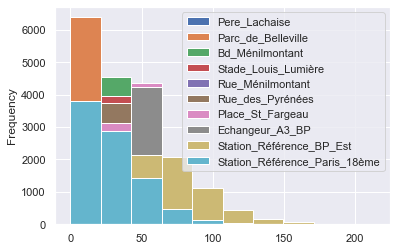

In [54]:
data.plot(kind='hist')

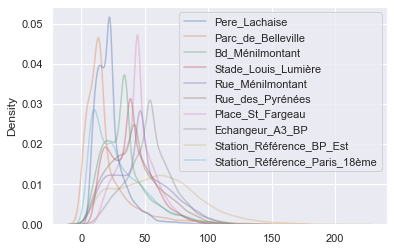

In [55]:
sns.kdeplot(data=data, fill=False, common_norm=False, alpha=0.4)
plt.show()

A titre indicatif, les seuils réglementaires de NO2 sont de **40 µg/m3 pour l'exposition chronique**
et de **200 µg/m3 pour une exposition plus inhabituelle**.

#### Exposition chronique sur l'année

In [56]:
data.mean()

/var/folders/b9/5kv9j4kn0mjgnpxsk1mvs2f80000gn/T/ipykernel_1334/531903386.py:1: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  data.mean()


Pere_Lachaise                    22.484498
Parc_de_Belleville               19.969951
Bd_Ménilmontant                  34.148261
Stade_Louis_Lumière              38.560642
Rue_Ménilmontant                 46.407882
Rue_des_Pyrénées                 41.686898
Place_St_Fargeau                 44.150209
Echangeur_A3_BP                  54.128323
Station_Référence_BP_Est         60.637055
Station_Référence_Paris_18ème    29.696735
dtype: float64

/var/folders/b9/5kv9j4kn0mjgnpxsk1mvs2f80000gn/T/ipykernel_1334/2945710734.py:1: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  data.mean().plot(kind='hist')


<AxesSubplot:ylabel='Frequency'>

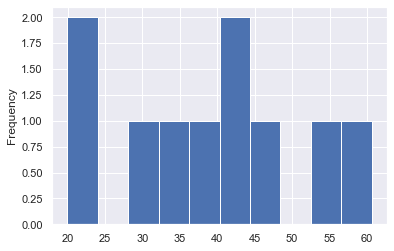

In [57]:
data.mean().plot(kind='hist')

Avec la moyenne des données par station sur la période du 1er janvier 2019 au 31 décembre 2019, nous pouvons nous apercevoir que certaines stations ont une moyenne supérieure au seuil réglementaire.
C'est le cas pour les stations suivantes:   
        -> Station Rue Ménilmontant (46µg/m3)   
        -> Station Rue des Pyrénées (41µg/m3)  
        -> Station Place St Fargeau (44µg/m3)  
        -> Station Echangeur A3 (54µg/m3)  
        -> Station Référence BP Est (60µg/m3)  

In [58]:
data.quantile(0.50)

Pere_Lachaise                    20.870351
Parc_de_Belleville               13.925615
Bd_Ménilmontant                  34.148261
Stade_Louis_Lumière              38.560642
Rue_Ménilmontant                 46.407882
Rue_des_Pyrénées                 41.622235
Place_St_Fargeau                 44.150209
Echangeur_A3_BP                  54.128323
Station_Référence_BP_Est         59.400000
Station_Référence_Paris_18ème    24.300000
Name: 0.5, dtype: float64

<AxesSubplot:ylabel='Frequency'>

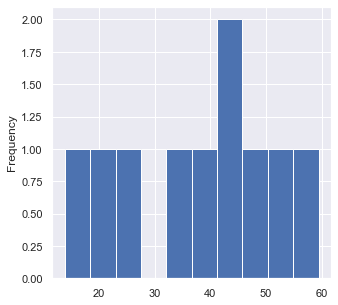

In [59]:
data.quantile(0.50).plot(kind='hist', figsize=(5,5))

Pour les mêmes stations, nous pouvons voir que 50% des données sont supérieures au seuil réglemenaire.   
Cela peut poser question si on lie au temps d'explosition

In [60]:
data.quantile(0.75)

Pere_Lachaise                    26.141510
Parc_de_Belleville               23.261058
Bd_Ménilmontant                  40.856889
Stade_Louis_Lumière              48.842551
Rue_Ménilmontant                 59.869318
Rue_des_Pyrénées                 53.830406
Place_St_Fargeau                 51.724130
Echangeur_A3_BP                  64.680956
Station_Référence_BP_Est         80.700000
Station_Référence_Paris_18ème    41.525000
Name: 0.75, dtype: float64

<AxesSubplot:ylabel='Frequency'>

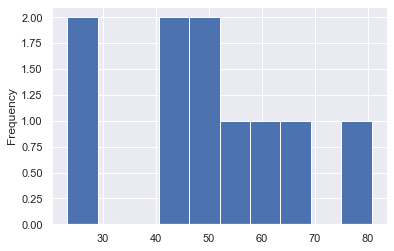

In [61]:
data.quantile(0.75).plot(kind='hist')

Si on prend en compte 75% des données, excepté les stations Père Lachaise et Parc de Belleville, toutes les autres stations ont des données supérieures au seuil réglementaire.

#### Exposition chronique par mois

In [62]:
dataMM = data.groupby(['Month']).mean().round(2)
dataMM 

,Pere_Lachaise,Parc_de_Belleville,Bd_Ménilmontant,Stade_Louis_Lumière,Rue_Ménilmontant,Rue_des_Pyrénées,Place_St_Fargeau,Echangeur_A3_BP,Station_Référence_BP_Est,Station_Référence_Paris_18ème
Month,,,,,,,,,,
2019-01,22.66,18.29,33.80,40.01,47.79,43.43,46.78,56.27,55.28,43.61
2019-02,37.04,43.32,52.96,55.93,63.02,59.31,58.62,71.93,79.65,56.82
2019-03,22.23,23.44,29.11,38.21,42.82,40.16,47.48,54.11,55.11,37.44
2019-04,21.52,18.11,31.02,42.51,46.84,40.87,44.57,52.70,73.59,39.09
2019-05,19.37,16.22,30.50,33.91,39.63,42.50,43.29,46.84,53.84,31.45
2019-06,19.50,15.00,37.39,40.21,51.22,44.73,44.57,58.93,65.21,16.84
2019-07,21.67,16.61,34.91,36.43,39.88,40.15,41.89,52.11,60.24,11.89
2019-08,18.06,14.56,34.04,28.53,46.07,38.34,37.99,49.42,55.30,10.86
2019-09,18.39,13.81,31.38,22.10,40.42,35.25,34.26,49.94,49.97,10.84


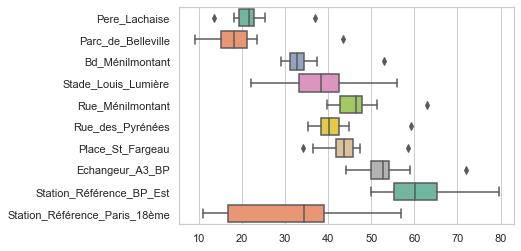

In [63]:
sns.set_theme(style="whitegrid")
ax = sns.boxplot(data=dataMM , orient="h", palette="Set2")

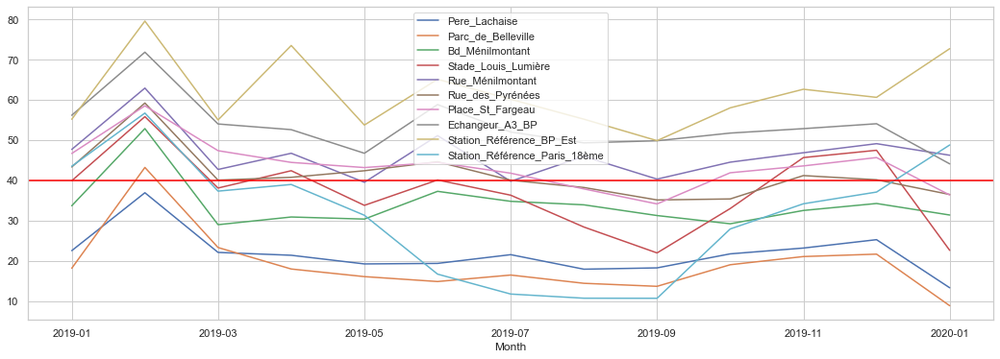

In [64]:
dataMM.plot(figsize=(18,6))
plt.axhline(y=40, color='red')

#### Exposition inhabituelle sur l'année

In [65]:
data.max()

heure_de_la_mesure                 23:00:00
Month                               2020-01
Pere_Lachaise                    113.782096
Parc_de_Belleville               169.957657
Bd_Ménilmontant                  117.436565
Stade_Louis_Lumière                107.0712
Rue_Ménilmontant                 130.014038
Rue_des_Pyrénées                  110.96734
Place_St_Fargeau                  99.980426
Echangeur_A3_BP                  138.491991
Station_Référence_BP_Est              213.7
Station_Référence_Paris_18ème         139.8
dtype: object

Concenrnant les **expositions inhabituelles**, seule la station Référence BP Est (213µg/m3) dépasse le seuil réglementaire.

#### Exposition inhabituelle par mois

In [66]:
dataIM = data.groupby(['Month']).max().round(2)
dataIM 

,heure_de_la_mesure,Pere_Lachaise,Parc_de_Belleville,Bd_Ménilmontant,Stade_Louis_Lumière,Rue_Ménilmontant,Rue_des_Pyrénées,Place_St_Fargeau,Echangeur_A3_BP,Station_Référence_BP_Est,Station_Référence_Paris_18ème
Month,,,,,,,,,,,
2019-01,23:00:00,60.90,85.84,80.77,74.33,98.01,97.94,81.62,111.13,151.7,108.4
2019-02,23:00:00,113.78,163.74,117.18,103.35,119.72,107.90,98.96,138.49,172.4,134.2
2019-03,23:00:00,101.03,169.96,110.23,102.88,120.05,105.70,99.98,121.57,167.2,134.2
2019-04,23:00:00,70.33,154.22,101.86,100.91,99.64,92.59,92.84,108.69,179.6,139.8
2019-05,23:00:00,58.71,90.75,97.42,86.49,111.47,99.12,86.47,105.18,149.0,104.4
2019-06,23:00:00,52.07,61.77,107.60,81.52,111.16,99.98,81.48,112.28,158.9,86.1
2019-07,23:00:00,55.70,80.22,113.24,84.59,130.01,110.97,95.81,112.50,213.7,76.3
2019-08,23:00:00,53.19,82.64,101.65,81.44,113.94,99.84,87.50,111.72,179.4,36.1
2019-09,23:00:00,63.84,136.97,117.44,56.54,108.24,101.90,85.53,111.79,161.0,44.5


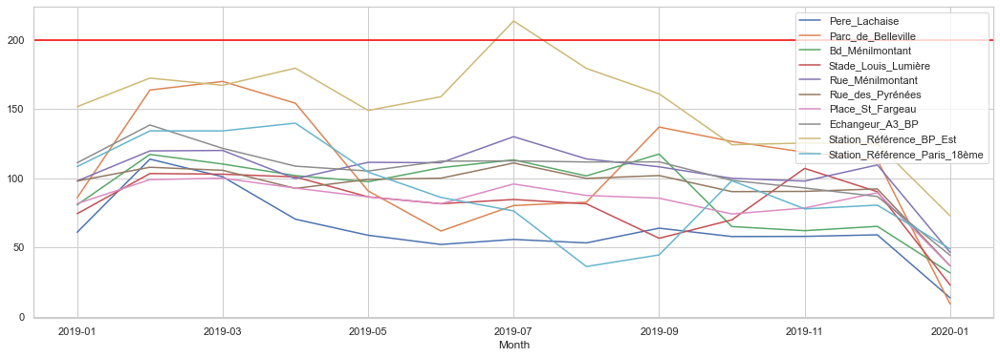

In [67]:
dataIM.plot(figsize=(18,6))
plt.axhline(y=200, color='red')

### Vacances scolaires

Une question qui peut se poser est le taux horaire de NO2 pendant les vancances. 
Cette question est assez légitime car le nombre d'habitants et de véhicules en déplacement diminue durant cette période. 

In [68]:
#La moyenne à l'année pour chaque station
datamean=data.mean()

/var/folders/b9/5kv9j4kn0mjgnpxsk1mvs2f80000gn/T/ipykernel_1334/3013218156.py:2: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  datamean=data.mean()


#### Vacances de février : 23 février - 11 mars

In [69]:
Vacsfev=data[(data.Month>='2019-02')&(data.Month<='2019-03')]

In [70]:
A=Vacsfev.mean()

/var/folders/b9/5kv9j4kn0mjgnpxsk1mvs2f80000gn/T/ipykernel_1334/886763741.py:1: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  A=Vacsfev.mean()


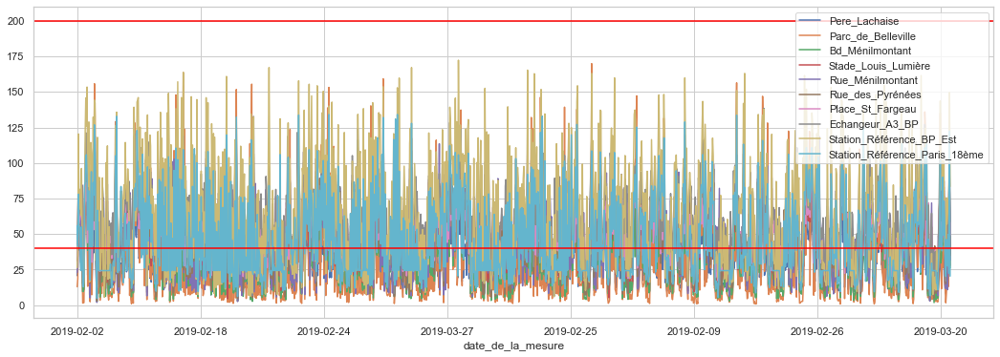

In [71]:
Vacsfev.plot(figsize=(18,6))
plt.axhline(y=40, color='red')
plt.axhline(y=200, color='red')

#### Vacances de Pâques: 20 avril - 6 mai

In [72]:
VacsPa=data[(data.Month>='2019-04')&(data.Month<='2019-05')]

In [73]:
B=VacsPa.mean()

/var/folders/b9/5kv9j4kn0mjgnpxsk1mvs2f80000gn/T/ipykernel_1334/407993365.py:1: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  B=VacsPa.mean()


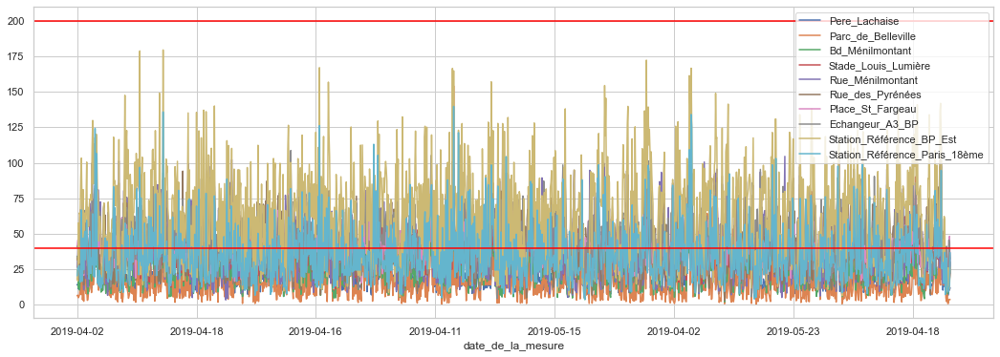

In [74]:
VacsPa.plot(figsize=(18,6))
plt.axhline(y=40, color='red')
plt.axhline(y=200, color='red')

#### Vacances d'été: 6 juillet - 30 aout/2 septembre

In [75]:
Vacsete=data[(data.Month>='2019-07')&(data.Month<='2019-09')]

In [76]:
C=Vacsete.mean()

/var/folders/b9/5kv9j4kn0mjgnpxsk1mvs2f80000gn/T/ipykernel_1334/1659832279.py:1: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  C=Vacsete.mean()


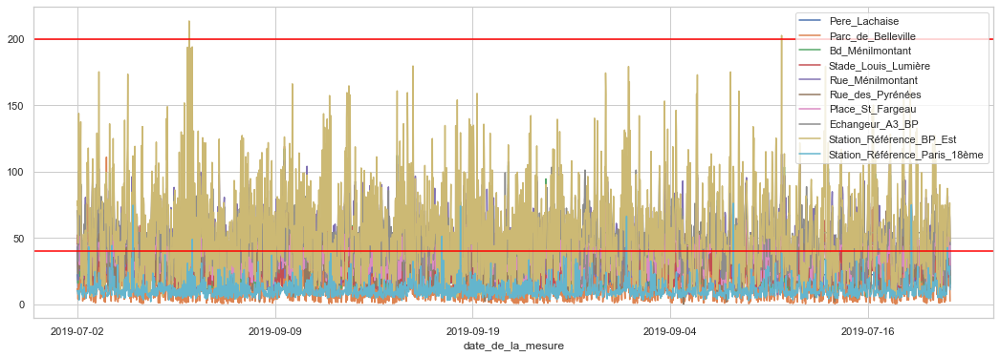

In [77]:
Vacsete.plot(figsize=(18,6))
plt.axhline(y=40, color='red')
plt.axhline(y=200, color='red')

In [78]:
Vacsete1=Vacsete.copy()
del Vacsete1['Station_Référence_BP_Est']

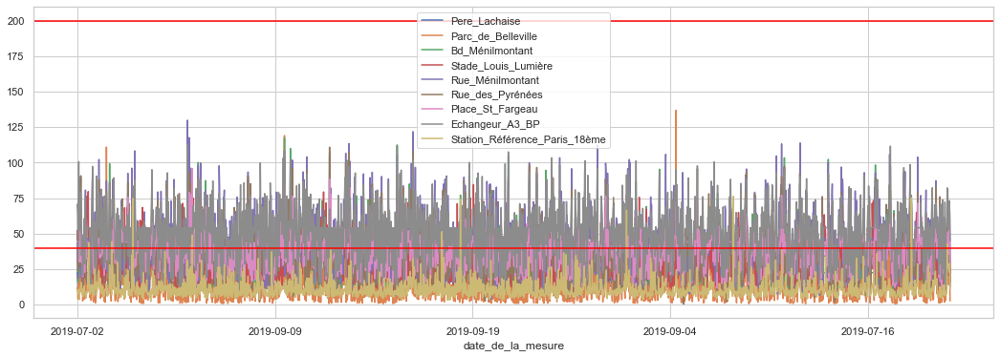

In [79]:
Vacsete1.plot(figsize=(18,6))
plt.axhline(y=40, color='red')
plt.axhline(y=200, color='red')

#### Vacances de Toussaint: 19 octobre - 4 novembre

In [80]:
VacsTou=data[(data.Month>='2019-10')&(data.Month<='2019-11')]

In [81]:
D=VacsTou.mean()

/var/folders/b9/5kv9j4kn0mjgnpxsk1mvs2f80000gn/T/ipykernel_1334/957012571.py:1: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  D=VacsTou.mean()


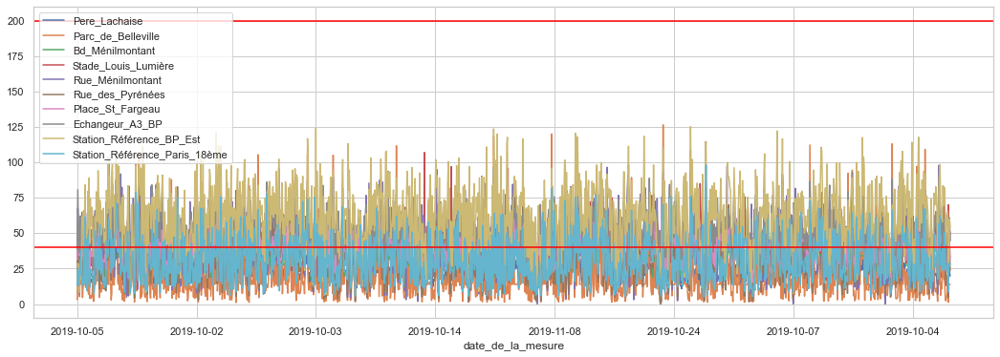

In [82]:
VacsTou.plot(figsize=(18,6))
plt.axhline(y=40, color='red')
plt.axhline(y=200, color='red')

In [83]:
Zonevacs={"Vacs_fevrier":A, "Vacs_Pacques":B, "Vacs_ete":C, "Vacs_Toussaint":D, "A l'année":datamean}
Zone=pd.DataFrame.from_dict(Zonevacs)
Zone

,Vacs_fevrier,Vacs_Pacques,Vacs_ete,Vacs_Toussaint,A l'année
Pere_Lachaise,29.258161,20.425862,19.382648,22.575669,22.484498
Parc_de_Belleville,32.877645,17.148986,15.007965,20.167625,19.969951
Bd_Ménilmontant,40.429488,30.757114,33.466494,30.965574,34.148261
Stade_Louis_Lumière,46.621091,38.140557,29.092492,39.344635,38.560642
Rue_Ménilmontant,52.405833,43.175441,42.140150,45.780227,46.407882
Rue_des_Pyrénées,49.247527,41.698107,37.942534,38.354727,41.686898
Place_St_Fargeau,52.770363,43.917947,38.084786,42.835798,44.150209
Echangeur_A3_BP,62.566081,49.719934,50.497958,52.389211,54.128323
Station_Référence_BP_Est,66.756215,63.548361,55.223687,60.389754,60.637055
Station_Référence_Paris_18ème,46.636935,35.210246,11.202129,31.126708,29.696735


### Différences entre les zones

Le site opendata.paris.fr d'ou proviennent les données nous donne certaines informations concernant l'environnement des mini-stations.


La station BP Est est située à proximité du trafic routier, au niveau du Périphérique Est.    
Les stations Paris 18e, Parc de Belleville et Père Lachaise sont les plus loin des sources directes de pollution.

#### Différence entre toutes les zones

In [84]:
dataMM.describe().T

,count,mean,std,min,25%,50%,75%,max
Pere_Lachaise,13.0,21.881538,5.438268,13.45,19.37,21.67,22.66,37.04
Parc_de_Belleville,13.0,19.271538,8.166562,9.00,15.00,18.11,21.20,43.32
Bd_Ménilmontant,13.0,34.074615,6.148036,29.11,31.02,32.64,34.37,52.96
Stade_Louis_Lumière,13.0,37.465385,9.650531,22.10,33.12,38.21,42.51,55.93
Rue_Ménilmontant,13.0,46.527692,6.122447,39.63,42.82,46.35,47.79,63.02
Rue_des_Pyrénées,13.0,41.416154,6.102017,35.25,38.34,40.26,42.50,59.31
Place_St_Fargeau,13.0,43.646923,6.001245,34.26,41.89,43.70,45.77,58.62
Echangeur_A3_BP,13.0,53.494615,6.728175,44.21,49.94,52.70,54.17,71.93
Station_Référence_BP_Est,13.0,61.735385,8.855482,49.97,55.28,60.24,65.21,79.65
Station_Référence_Paris_18ème,13.0,31.330769,14.965783,10.84,16.84,34.30,39.09,56.82


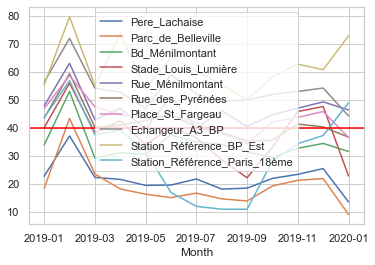

In [85]:
dataMM.plot()
plt.axhline(y=40, color='red')

In [86]:
dataIM.describe().T

,count,mean,std,min,25%,50%,75%,max
Pere_Lachaise,13.0,62.900769,23.970808,13.45,55.70,58.71,63.84,113.78
Parc_de_Belleville,13.0,107.201538,45.223604,9.00,82.64,113.18,136.97,169.96
Bd_Ménilmontant,13.0,90.083846,26.790519,31.51,65.16,101.65,110.23,117.44
Stade_Louis_Lumière,13.0,81.686154,22.980842,22.74,74.33,84.59,100.91,107.07
Rue_Ménilmontant,13.0,105.074615,20.111450,46.35,99.64,109.58,113.94,130.01
Rue_des_Pyrénées,13.0,94.270769,18.520890,36.61,92.24,99.12,101.90,110.97
Place_St_Fargeau,13.0,83.747692,16.189780,36.49,81.48,86.47,92.84,99.98
Echangeur_A3_BP,13.0,104.280769,22.095687,44.21,98.41,111.13,112.28,138.49
Station_Référence_BP_Est,13.0,152.315385,34.875848,72.80,125.40,158.90,172.40,213.70
Station_Référence_Paris_18ème,13.0,89.953846,34.286917,36.10,76.30,86.10,108.40,139.80


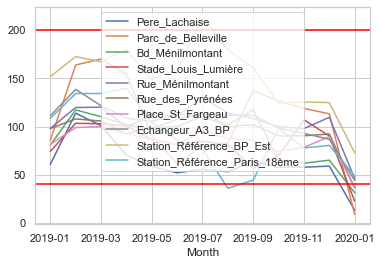

In [87]:
dataIM.plot()
plt.axhline(y=40, color='red')
plt.axhline(y=200, color='red')

#### Différence entre zones par secteur

##### Le périphérie

In [88]:
data_periph=data[['Month','Echangeur_A3_BP','Station_Référence_BP_Est']]

In [89]:
data_periph.describe().T

,count,mean,std,min,25%,50%,75%,max
Echangeur_A3_BP,8760.0,54.128323,18.565444,4.43995,42.457495,54.128323,64.680956,138.491991
Station_Référence_BP_Est,8760.0,60.637055,31.627102,4.40000,36.400000,59.400000,80.700000,213.700000


In [90]:
data_periph_month_mean=data_periph.groupby(['Month']).mean().round(2)
data_periph_month_max=data_periph.groupby(['Month']).max().round(2)

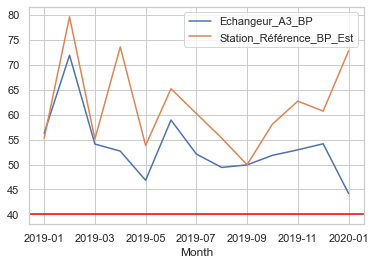

In [91]:
# La moyenne en zone périphérique par mois
data_periph_month_mean.plot()
plt.axhline(y=40, color='red')

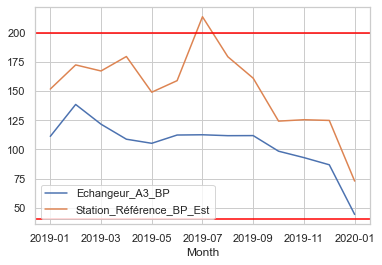

In [92]:
#Le maximum en zone périphérique par mois
data_periph_month_max.plot()
plt.axhline(y=40, color='red')
plt.axhline(y=200, color='red')

##### La zone urbaine

In [93]:
data_zone_urbaine=data[['Month','Bd_Ménilmontant','Rue_Ménilmontant','Rue_des_Pyrénées','Place_St_Fargeau','Station_Référence_Paris_18ème']]

In [94]:
data_zone_urbaine.describe().T

,count,mean,std,min,25%,50%,75%,max
Bd_Ménilmontant,8760.0,34.148261,18.206757,1.801964,21.274928,34.148261,40.856889,117.436565
Rue_Ménilmontant,8760.0,46.407882,21.872280,0.025318,29.877743,46.407882,59.869318,130.014038
Rue_des_Pyrénées,8760.0,41.686898,20.167455,0.054235,26.745490,41.622235,53.830406,110.967340
Place_St_Fargeau,8760.0,44.150209,14.239261,11.026864,35.058683,44.150209,51.724130,99.980426
Station_Référence_Paris_18ème,8760.0,29.696735,21.633493,2.000000,12.300000,24.300000,41.525000,139.800000


In [95]:
data_zone_urbaine_month_mean=data_zone_urbaine.groupby(['Month']).mean().round(2)
data_zone_urbaine_month_max=data_zone_urbaine.groupby(['Month']).max().round(2)

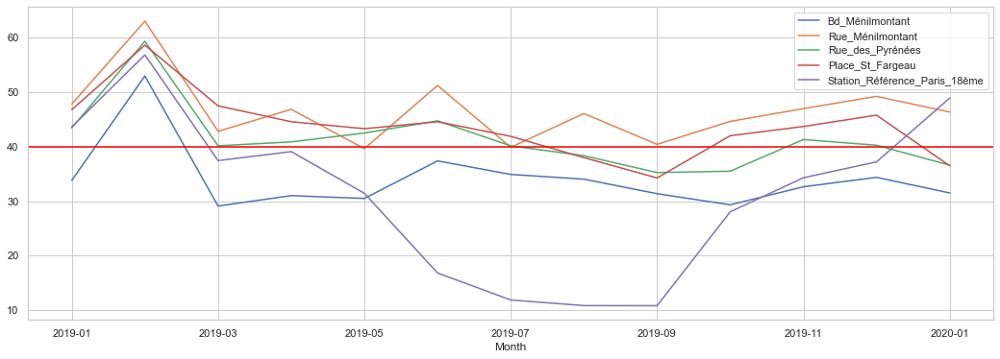

In [96]:
# La moyenne en zone urbaine par mois
data_zone_urbaine_month_mean.plot(figsize=(18,6))
plt.axhline(y=40, color='red')

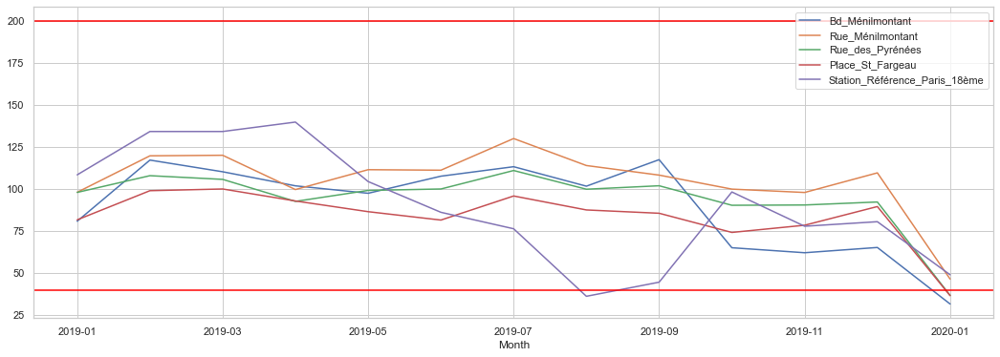

In [97]:
#Le maximum par mois en zone urbaine
data_zone_urbaine_month_max.plot(figsize=(18,6))
plt.axhline(y=40, color='red')
plt.axhline(y=200, color='red')

##### La zone non urbaine 

In [98]:
data_zone_non_urbaine=data[['Month','Pere_Lachaise','Parc_de_Belleville','Stade_Louis_Lumière']]

In [99]:
data_zone_non_urbaine.describe().T

,count,mean,std,min,25%,50%,75%,max
Pere_Lachaise,8760.0,22.484498,12.121777,5.277120,14.348507,20.870351,26.141510,113.782096
Parc_de_Belleville,8760.0,19.969951,20.433233,0.484373,8.135876,13.925615,23.261058,169.957657
Stade_Louis_Lumière,8760.0,38.560642,17.021287,4.515505,24.839267,38.560642,48.842551,107.071200


In [100]:
data_zone_non_urbaine_month_mean=data_zone_non_urbaine.groupby(['Month']).mean().round(2)
data_zone_non_urbaine_month_max=data_zone_non_urbaine.groupby(['Month']).max().round(2)

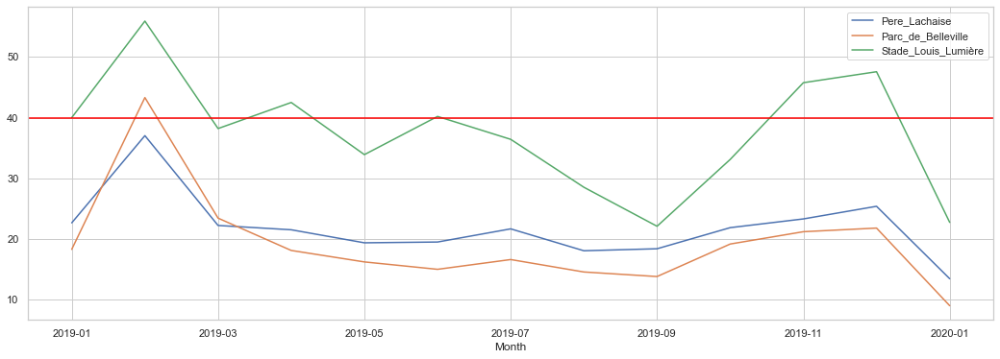

In [101]:
data_zone_non_urbaine_month_mean.plot(figsize=(18,6))
plt.axhline(y=40, color='red')

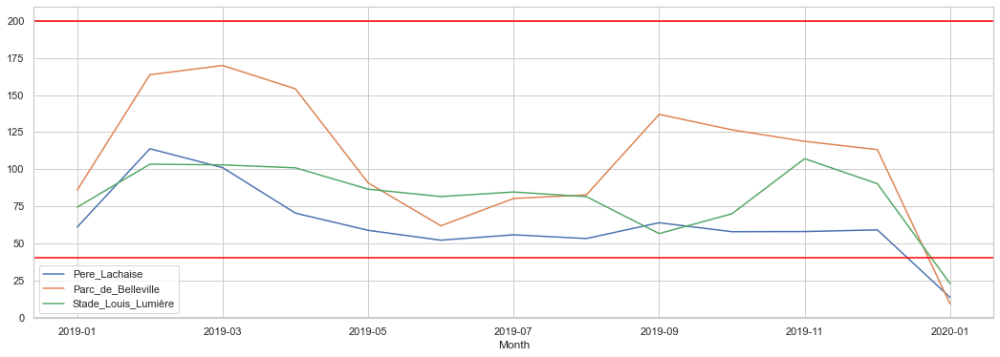

In [102]:
data_zone_non_urbaine_month_max.plot(figsize=(18,6))
plt.axhline(y=40, color='red')
plt.axhline(y=200, color='red')

#### Correlation entre les zones 

Text(0.5, 1.0, 'Correlation')

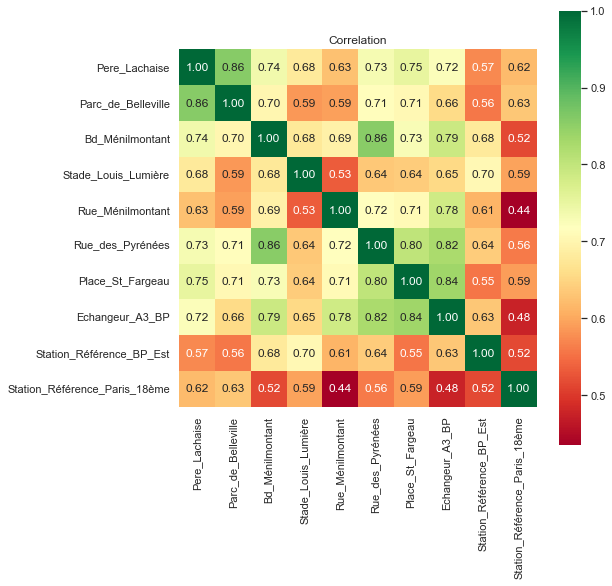

In [103]:
rcParams['figure.figsize'] = (8, 8)
sns.heatmap(data.corr(), annot=True,cmap='RdYlGn',square=True, fmt='.2f')
plt.title('Correlation')

### Conclusion

## Scrapping : https://prevision-meteo.ch/climat/mensuel/paris-montsouris/2019

https://prevision-meteo.ch/climat/mensuel/paris-montsouris/2019

In [104]:
url = 'https://prevision-meteo.ch/climat/mensuel/paris-montsouris/2019'
response = requests.get(url)
html = BeautifulSoup(response.text, 'html.parser')
conteneur = html.find('div', class_="toprint")

### Scrapping des données

##### Janvier

In [105]:
janv_temp_min = conteneur.find_all('td',style="color:#ffffff; background:RGB(85,198,229);")
janv_temp_min1=[]
for i in janv_temp_min:
    titre=i.text
    janv_temp_min1.append(i.text)
janv_temp_min1= [float(item) for item in janv_temp_min1]

In [106]:
janv_temp_max=conteneur.find_all('td', style="color:#000000; background:RGB(255,220,0);")
janv_temp_max1=[]
for i in janv_temp_max:
    titre=i.text
    janv_temp_max1.append(i.text)
janv_temp_max1= [float(item) for item in janv_temp_max1]

In [107]:
janv_temp_moy=conteneur.find_all('td', style='color:#000000; background:RGB(174,251,122);')
janv_temp_moy1=[]
for i in janv_temp_moy:
    titre=i.text
    janv_temp_moy1.append(i.text)
janv_temp_moy1= [float(item) for item in janv_temp_moy1]

In [108]:
janv_vent_max=conteneur.find_all('td', style='color:#ffffff; background:RGB(89,228,52);')
janv_vent_max1=[]
for i in janv_vent_max:
    titre=i.text
    janv_vent_max1.append(i.text)
janv_vent_max1= [float(item) for item in janv_vent_max1]

In [109]:
janv_précipitations=conteneur.find_all('td', style="color:#000000; background:RGB(153,239,177);")
janv_précipitations1=[]
for i in janv_précipitations:
    titre=i.text
    janv_précipitations1.append(i.text)
janv_précipitations1= [float(item) for item in janv_précipitations1]

In [110]:
janv_pression_min=conteneur.find('td', style="color:#000000; background:RGB(228,252,198);")
janv_pression_min1=[]
for i in janv_pression_min:
    titre=i.text
    janv_pression_min1.append(i.text)
janv_pression_min1= [float(item) for item in janv_pression_min1]

In [111]:
janv_pression_max=conteneur.find_all('td', style="color:#000000; background:RGB(255,134,0);")
janv_pression_max1=[]
for i in janv_pression_max:
    titre=i.text
    janv_pression_max1.append(i.text)
janv_pression_max1= [float(item) for item in janv_pression_max1]

In [112]:
janvier = janv_temp_min1 + janv_temp_max1 + janv_temp_moy1 + janv_vent_max1 + janv_précipitations1 + janv_pression_min1 + janv_pression_max1

In [113]:
df=pd.DataFrame(columns=['Température_min', 'Temperature_max','Temperature_moy','Vent_max', 'Precipitaiontions_totales', 'Pression_min', 'Pression_max'])

In [114]:
df

,Température_min,Temperature_max,Temperature_moy,Vent_max,Precipitaiontions_totales,Pression_min,Pression_max


In [115]:
df.loc[1]=janvier

In [116]:
df=df.rename(index={1: '2019-01'})

##### Février

In [117]:
fev_temp_min = conteneur.find_all('td',style="color:#ffffff; background:RGB(96,231,231);")
fev_temp_min1=[]
for i in fev_temp_min:
    titre=i.text
    fev_temp_min1.append(i.text)
fev_temp_min1= [float(item) for item in fev_temp_min1]

In [118]:
fev_temp_max=conteneur.find_all('td', style="color:#000000; background:RGB(254,67,2);")
fev_temp_max1=[]
for i in fev_temp_max:
    titre=i.text
    fev_temp_max1.append(i.text)
fev_temp_max1= [float(item) for item in fev_temp_max1]

In [119]:
fev_temp_moy=conteneur.find_all('td', style='color:#000000; background:RGB(226,254,43);')
fev_temp_moy1=[]
for i in fev_temp_moy:
    titre=i.text
    fev_temp_moy1.append(i.text)
fev_temp_moy1= [float(item) for item in fev_temp_moy1]

In [120]:
fev_vent_max=conteneur.find('td', style='color:#000000; background:RGB(184,226,22);')
fev_vent_max1=[]
for i in fev_vent_max:
    titre=i.text
    fev_vent_max1.append(i.text)
fev_vent_max1= [float(item) for item in fev_vent_max1]

In [121]:
fev_précipitations=conteneur.find_all('td', style="color:#000000; background:RGB(182,248,193);")
fev_précipitations1=[]
for i in fev_précipitations:
    titre=i.text
    fev_précipitations1.append(i.text)
fev_précipitations1= [float(item) for item in fev_précipitations1]

In [122]:
fev_pression_min=conteneur.find('td', style="color:#000000; background:RGB(218,250,166);")
fev_pression_min1=[]
for i in fev_pression_min:
    titre=i.text
    fev_pression_min1.append(i.text)
fev_pression_min1= [float(item) for item in fev_pression_min1]

In [123]:
fev_pression_max=conteneur.find_all('td', style="color:#000000; background:RGB(255,158,0);")
fev_pression_max1=[]
for i in fev_pression_max:
    titre=i.text
    fev_pression_max1.append(i.text)
fev_pression_max1= [float(item) for item in fev_pression_max1]

In [124]:
fevrier = fev_temp_min1 + fev_temp_max1 + fev_temp_moy1 + fev_vent_max1 + fev_précipitations1 + fev_pression_min1 + fev_pression_max1

In [125]:
df.loc[2]=fevrier

In [126]:
df=df.rename(index={2: '2019-02'})

##### Mars

In [127]:
mars_temp_min = conteneur.find_all('td',style="color:#000000; background:RGB(164,250,137);")
mars_temp_min1=[]
for i in mars_temp_min:
    titre=i.text
    mars_temp_min1.append(i.text)
mars_temp_min1= [float(item) for item in mars_temp_min1]

In [128]:
mars_temp_max=conteneur.find_all('td', style="color:#000000; background:RGB(250,62,9);")
mars_temp_max1=[]
for i in mars_temp_max:
    titre=i.text
    mars_temp_max1.append(i.text)
mars_temp_max1= [float(item) for item in mars_temp_max1]

In [129]:
mars_temp_moy=conteneur.find_all('td', style='color:#000000; background:RGB(255,252,0);')
mars_temp_moy1=[]
for i in mars_temp_moy:
    titre=i.text
    mars_temp_moy1.append(i.text)
mars_temp_moy1= [float(item) for item in mars_temp_moy1]

In [130]:
mars_vent_max=conteneur.find('td', style='color:#000000; background:RGB(184,226,22);')
mars_vent_max1=[]
for i in mars_vent_max:
    titre=i.text
    mars_vent_max1.append(i.text)
mars_vent_max1= [float(item) for item in mars_vent_max1]

In [131]:
mars_précipitations=conteneur.find_all('td', style="color:#000000; background:RGB(164,242,183);")
mars_précipitations1=[]
for i in mars_précipitations:
    titre=i.text
    mars_précipitations1.append(i.text)
mars_précipitations1= [float(item) for item in mars_précipitations1]

In [132]:
mars_pression_min=conteneur.find('td', style="color:#000000; background:RGB(203,246,113);")
mars_pression_min1=[]
for i in mars_pression_min:
    titre=i.text
    mars_pression_min1.append(i.text)
mars_pression_min1= [float(item) for item in mars_pression_min1]

In [133]:
mars_pression_max=conteneur.find_all('td', style="color:#000000; background:RGB(255,171,0);")
mars_pression_max1=[]
for i in mars_pression_max:
    titre=i.text
    mars_pression_max1.append(i.text)
mars_pression_max1= [float(item) for item in mars_pression_max1]

In [134]:
mars = mars_temp_min1 + mars_temp_max1 + mars_temp_moy1 + mars_vent_max1 + mars_précipitations1 + mars_pression_min1 + mars_pression_max1

In [135]:
df.loc[3]=mars

In [136]:
df=df.rename(index={3: '2019-03'})

##### Avril

In [137]:
avril_temp_min = conteneur.find_all('td',style="color:#ffffff; background:RGB(116,248,209);")
avril_temp_min1=[]
for i in avril_temp_min:
    titre=i.text
    avril_temp_min1.append(i.text)
avril_temp_min1= [float(item) for item in avril_temp_min1]

In [138]:
avril_temp_max=conteneur.find_all('td', style="color:#000000; background:RGB(230,34,43);")
avril_temp_max1=[]
for i in avril_temp_max:
    titre=i.text
    avril_temp_max1.append(i.text)
avril_temp_max1= [float(item) for item in avril_temp_max1]

In [139]:
avril_temp_moy=conteneur.find('td', style='color:#000000; background:RGB(255,210,0);')
avril_temp_moy1=[]
for i in avril_temp_moy:
    titre=i.text
    avril_temp_moy1.append(i.text)
avril_temp_moy1= [float(item) for item in avril_temp_moy1]

In [140]:
avril_vent_max=conteneur.find_all('td', style='color:#000000; background:RGB(161,227,30);')
avril_vent_max1=[]
for i in avril_vent_max:
    titre=i.text
    avril_vent_max1.append(i.text)
avril_vent_max1= [float(item) for item in avril_vent_max1]

In [141]:
avril_précipitations=conteneur.find_all('td', style="color:#000000; background:RGB(213,254,202);")
avril_précipitations1=[]
for i in avril_précipitations:
    titre=i.text
    avril_précipitations1.append(i.text)
avril_précipitations1= [float(item) for item in avril_précipitations1]

In [142]:
avril_pression_min=conteneur.find('td', style="color:#000000; background:RGB(189,243,66);")
avril_pression_min1=[]
for i in avril_pression_min:
    titre=i.text
    avril_pression_min1.append(i.text)
avril_pression_min1= [float(item) for item in avril_pression_min1]

In [143]:
avril_pression_max=conteneur.find_all('td', style="color:#000000; background:RGB(255,215,53);")
avril_pression_max1=[]
for i in avril_pression_max:
    titre=i.text
    avril_pression_max1.append(i.text)
avril_pression_max1= [float(item) for item in avril_pression_max1]

In [144]:
avril = avril_temp_min1 + avril_temp_max1 + avril_temp_moy1 + avril_vent_max1 + avril_précipitations1 + avril_pression_min1 + avril_pression_max1

In [145]:
df.loc[4]=avril

In [146]:
df=df.rename(index={4: '2019-04'})

##### Mai 

In [147]:
mai_temp_min = conteneur.find_all('td',style="color:#000000; background:RGB(156,250,148);")
mai_temp_min1=[]
for i in mai_temp_min:
    titre=i.text
    mai_temp_min1.append(i.text)
mai_temp_min1= [float(item) for item in mai_temp_min1]

In [148]:
mai_temp_max=conteneur.find_all('td', style="color:#000000; background:RGB(234,40,35);")
mai_temp_max1=[]
for i in mai_temp_max:
    titre=i.text
    mai_temp_max1.append(i.text)
mai_temp_max1= [float(item) for item in mai_temp_max1]

In [149]:
mai_temp_moy=conteneur.find_all('td', style='color:#000000; background:RGB(255,178,0);')
mai_temp_moy1=[]
for i in mai_temp_moy:
    titre=i.text
    mai_temp_moy1.append(i.text)
mai_temp_moy1= [float(item) for item in mai_temp_moy1]

In [150]:
mai_vent_max=conteneur.find('td', style='color:#ffffff; background:RGB(19,230,74);')
mai_vent_max1=[]
for i in mai_vent_max:
    titre=i.text
    mai_vent_max1.append(i.text)
mai_vent_max1= [float(item) for item in mai_vent_max1]

In [151]:
mai_précipitations=conteneur.find_all('td', style="color:#ffffff; background:RGB(48,161,157);")
mai_précipitations1=[]
for i in mai_précipitations:
    titre=i.text
    mai_précipitations1.append(i.text)
mai_précipitations1= [float(item) for item in mai_précipitations1]

In [152]:
mai_pression_min=conteneur.find('td', style="color:#000000; background:RGB(201,246,107);")
mai_pression_min1=[]
for i in mai_pression_min:
    titre=i.text
    mai_pression_min1.append(i.text)
mai_pression_min1= [float(item) for item in mai_pression_min1]

In [153]:
mai_pression_max=conteneur.find_all('td', style="color:#000000; background:RGB(255,163,0);")
mai_pression_max1=[]
for i in mai_pression_max:
    titre=i.text
    mai_pression_max1.append(i.text)
mai_pression_max1= [float(item) for item in mai_pression_max1]

In [154]:
mai= mai_temp_min1 + mai_temp_max1 + mai_temp_moy1 + mai_vent_max1 + mai_précipitations1 + mai_pression_min1 + mai_pression_max1

In [155]:
df.loc[5]=mai

In [156]:
df=df.rename(index={5: '2019-05'})

##### Juin 

In [157]:
juin_temp_min = conteneur.find_all('td',style="color:#000000; background:RGB(247,255,12);")
juin_temp_min1=[]
for i in juin_temp_min:
    titre=i.text
    juin_temp_min1.append(i.text)
juin_temp_min1= [float(item) for item in juin_temp_min1]

In [158]:
juin_temp_max=conteneur.find_all('td', style="color:#000000; background:RGB(145,17,48);")
juin_temp_max1=[]
for i in juin_temp_max:
    titre=i.text
    juin_temp_max1.append(i.text)
juin_temp_max1= [float(item) for item in juin_temp_max1]

In [159]:
juin_temp_moy=conteneur.find_all('td', style='color:#000000; background:RGB(253,67,3);')
juin_temp_moy1=[]
for i in juin_temp_moy:
    titre=i.text
    juin_temp_moy1.append(i.text)
juin_temp_moy1= [float(item) for item in juin_temp_moy1]

In [160]:
juin_vent_max=conteneur.find('td', style='color:#000000; background:RGB(136,227,37);')
juin_vent_max1=[]
for i in juin_vent_max:
    titre=i.text
    juin_vent_max1.append(i.text)
juin_vent_max1= [float(item) for item in juin_vent_max1]

In [161]:
juin_précipitations=conteneur.find_all('td', style="color:#000000; background:RGB(151,237,176);")
juin_précipitations1=[]
for i in juin_précipitations:
    titre=i.text
    juin_précipitations1.append(i.text)
juin_précipitations1= [float(item) for item in juin_précipitations1]

In [162]:
juin_pression_min=conteneur.find('td', style="color:#000000; background:RGB(181,240,34);")
juin_pression_min1=[]
for i in juin_pression_min:
    titre=i.text
    juin_pression_min1.append(i.text)
juin_pression_min1= [float(item) for item in juin_pression_min1]

In [163]:
juin_pression_max=conteneur.find_all('td', style="color:#000000; background:RGB(255,226,109);")
juin_pression_max1=[]
for i in juin_pression_max:
    titre=i.text
    juin_pression_max1.append(i.text)
juin_pression_max1= [float(item) for item in juin_pression_max1]

In [164]:
juin= juin_temp_min1 + juin_temp_max1 + juin_temp_moy1 + juin_vent_max1 + juin_précipitations1 + juin_pression_min1 + juin_pression_max1

In [165]:
df.loc[6]=juin

In [166]:
df=df.rename(index={6: '2019-06'})

##### Juillet 

In [167]:
juillet_temp_min = conteneur.find_all('td',style="color:#000000; background:RGB(255,195,0);")
juillet_temp_min1=[]
for i in juillet_temp_min:
    titre=i.text
    juillet_temp_min1.append(i.text)
juillet_temp_min1= [float(item) for item in juillet_temp_min1]

juillet_temp_max=conteneur.find_all('td', style="color:#000000; background:RGB(189,47,189);")
juillet_temp_max1=[]
for i in juillet_temp_max:
    titre=i.text
    juillet_temp_max1.append(i.text)
juillet_temp_max1= [float(item) for item in juillet_temp_max1]

juillet_temp_moy=conteneur.find_all('td', style='color:#000000; background:RGB(246,56,16);')
juillet_temp_moy1=[]
for i in juillet_temp_moy:
    titre=i.text
    juillet_temp_moy1.append(i.text)
juillet_temp_moy1= [float(item) for item in juillet_temp_moy1]

juillet_vent_max=conteneur.find('td', style='color:#ffffff; background:RGB(66,229,59);')
juillet_vent_max1=[]
for i in juillet_vent_max:
    titre=i.text
    juillet_vent_max1.append(i.text)
juillet_vent_max1= [float(item) for item in juillet_vent_max1]

juillet_précipitations=conteneur.find_all('td', style="color:#000000; background:RGB(212,254,203);")
juillet_précipitations1=[]
for i in juillet_précipitations:
    titre=i.text
    juillet_précipitations1.append(i.text)
    juillet_précipitations1= [float(item) for item in juillet_précipitations1]

juillet_pression_min=conteneur.find('td', style="color:#000000; background:RGB(197,243,80);")
juillet_pression_min1=[]
for i in juillet_pression_min:
    titre=i.text
    juillet_pression_min1.append(i.text)
juillet_pression_min1= [float(item) for item in juillet_pression_min1]

juillet_pression_max=conteneur.find_all('td', style="color:#000000; background:RGB(255,223,97);")
juillet_pression_max1=[]
for i in juillet_pression_max:
    titre=i.text
    juillet_pression_max1.append(i.text)
juillet_pression_max1= [float(item) for item in juillet_pression_max1]

In [168]:
juillet= juillet_temp_min1 + juillet_temp_max1 + juillet_temp_moy1 + juillet_vent_max1 + juillet_précipitations1 + juillet_pression_min1 + juillet_pression_max1
df.loc[7]=juillet
df=df.rename(index={7: '2019-07'})

##### Aout

In [169]:
aout_temp_min = conteneur.find('td',style="color:#000000; background:RGB(255,210,0);")
aout_temp_min1=[]
for i in aout_temp_min:
    titre=i.text
    aout_temp_min1.append(i.text)
aout_temp_min1= [float(item) for item in aout_temp_min1]

aout_temp_max=conteneur.find('td', style="color:#000000; background:RGB(165,6,19);")
aout_temp_max1=[]
for i in aout_temp_max:
    titre=i.text
    aout_temp_max1.append(i.text)
aout_temp_max1= [float(item) for item in aout_temp_max1]

aout_temp_moy=conteneur.find('td', style='color:#000000; background:RGB(255,69,0);')
aout_temp_moy1=[]
for i in aout_temp_moy:
    titre=i.text
    aout_temp_moy1.append(i.text)
aout_temp_moy1= [float(item) for item in aout_temp_moy1]

aout_vent_max=conteneur.find('td', style='color:#ffffff; background:RGB(42,229,67);')
aout_vent_max1=[]
for i in aout_vent_max:
    titre=i.text
    aout_vent_max1.append(i.text)
aout_vent_max1= [float(item) for item in aout_vent_max1]

aout_précipitations=conteneur.find('td', style="color:#ffffff; background:RGB(48,161,156);")
aout_précipitations1=[]
for i in aout_précipitations:
    titre=i.text
    aout_précipitations1.append(i.text)
aout_précipitations1= [float(item) for item in aout_précipitations1]

aout_pression_min=conteneur.find('td', style="color:#000000; background:RGB(196,243,77);")
aout_pression_min1=[]
for i in aout_pression_min:
    titre=i.text
    aout_pression_min1.append(i.text)
aout_pression_min1= [float(item) for item in aout_pression_min1]

aout_pression_max=conteneur.find('td', style="color:#000000; background:RGB(255,208,20);")
aout_pression_max1=[]
for i in aout_pression_max:
    titre=i.text
    aout_pression_max1.append(i.text)
aout_pression_max1= [float(item) for item in aout_pression_max1]

In [170]:
aout= aout_temp_min1 + aout_temp_max1 + aout_temp_moy1 + aout_vent_max1 + aout_précipitations1 + aout_pression_min1 + aout_pression_max1

In [171]:
df.loc[8]=aout
df=df.rename(index={8: '2019-08'})

##### Septembre 

In [172]:
sept_temp_min = conteneur.find('td',style="color:#000000; background:RGB(253,255,2);")
sept_temp_min1=[]
for i in sept_temp_min:
    titre=i.text
    sept_temp_min1.append(i.text)
sept_temp_min1= [float(item) for item in sept_temp_min1]

sept_temp_max=conteneur.find('td', style="color:#000000; background:RGB(228,31,46);")
sept_temp_max1=[]
for i in sept_temp_max:
    titre=i.text
    sept_temp_max1.append(i.text)
sept_temp_max1= [float(item) for item in sept_temp_max1]

sept_temp_moy=conteneur.find('td', style='color:#000000; background:RGB(255,118,0);')
sept_temp_moy1=[]
for i in sept_temp_moy:
    titre=i.text
    sept_temp_moy1.append(i.text)
sept_temp_moy1= [float(item) for item in sept_temp_moy1]

sept_vent_max=conteneur.find('td', style='color:#000000; background:RGB(255,225,0);')
sept_vent_max1=[]
for i in sept_vent_max:
    titre=i.text
    sept_vent_max1.append(i.text)
sept_vent_max1= [float(item) for item in sept_vent_max1]

sept_précipitations=conteneur.find('td', style="color:#000000; background:RGB(204,255,204);")
sept_précipitations1=[]
for i in sept_précipitations:
    titre=i.text
    sept_précipitations1.append(i.text)
sept_précipitations1= [float(item) for item in sept_précipitations1]

sept_pression_min=conteneur.find('td', style="color:#000000; background:RGB(184,241,41);")
sept_pression_min1=[]
for i in sept_pression_min:
    titre=i.text
    sept_pression_min1.append(i.text)
sept_pression_min1= [float(item) for item in sept_pression_min1]

sept_pression_max=conteneur.find('td', style="color:#000000; background:RGB(255,181,0);")
sept_pression_max1=[]
for i in sept_pression_max:
    titre=i.text
    sept_pression_max1.append(i.text)
sept_pression_max1= [float(item) for item in sept_pression_max1]

In [173]:
sept= sept_temp_min1 + sept_temp_max1 +sept_temp_moy1 + sept_vent_max1 + sept_précipitations1 + sept_pression_min1 + sept_pression_max1

In [174]:
df.loc[9]=sept
df=df.rename(index={9: '2019-09'})

##### Octobre 

In [175]:
oct_temp_min = conteneur.find('td',style="color:#000000; background:RGB(187,251,102);")
oct_temp_min1=[]
for i in oct_temp_min:
    titre=i.text
    oct_temp_min1.append(i.text)
oct_temp_min1= [float(item) for item in oct_temp_min1]

oct_temp_max=conteneur.find('td', style="color:#000000; background:RGB(238,45,29);")
oct_temp_max1=[]
for i in oct_temp_max:
    titre=i.text
    oct_temp_max1.append(i.text)
oct_temp_max1= [float(item) for item in oct_temp_max1]

oct_temp_moy=conteneur.find('td', style='color:#000000; background:RGB(255,192,0);')
oct_temp_moy1=[]
for i in oct_temp_moy:
    titre=i.text
    oct_temp_moy1.append(i.text)
oct_temp_moy1= [float(item) for item in oct_temp_moy1]

oct_vent_max=conteneur.find('td', style='color:#000000; background:RGB(136,227,37);')
oct_vent_max1=[]
for i in oct_vent_max:
    titre=i.text
    oct_vent_max1.append(i.text)
oct_vent_max1= [float(item) for item in oct_vent_max1]

oct_précipitations=conteneur.find('td', style="color:#ffffff; background:RGB(98,200,163);")
oct_précipitations1=[]
for i in oct_précipitations:
    titre=i.text
    oct_précipitations1.append(i.text)
oct_précipitations1= [float(item) for item in oct_précipitations1]

oct_pression_min=conteneur.find('td', style="color:#000000; background:RGB(181,240,34);")
oct_pression_min1=[]
for i in oct_pression_min:
    titre=i.text
    oct_pression_min1.append(i.text)
oct_pression_min1= [float(item) for item in oct_pression_min1]

oct_pression_max=conteneur.find('td', style="color:#000000; background:RGB(255,219,77);")
oct_pression_max1=[]
for i in oct_pression_max:
    titre=i.text
    oct_pression_max1.append(i.text)
oct_pression_max1= [float(item) for item in oct_pression_max1]

In [176]:
octo= oct_temp_min1 + oct_temp_max1 +oct_temp_moy1 + oct_vent_max1 + oct_précipitations1 + oct_pression_min1 + oct_pression_max1

In [177]:
df.loc[10]=octo
df=df.rename(index={10: '2019-10'})

##### Novembre 

In [178]:
nov_temp_min = conteneur.find('td',style="color:#ffffff; background:RGB(112,248,216);")
nov_temp_min1=[]
for i in nov_temp_min:
    titre=i.text
    nov_temp_min1.append(i.text)
nov_temp_min1= [float(item) for item in nov_temp_min1]

nov_temp_max=conteneur.find('td', style="color:#000000; background:RGB(255,143,0);")
nov_temp_max1=[]
for i in nov_temp_max:
    titre=i.text
    nov_temp_max1.append(i.text)
nov_temp_max1= [float(item) for item in nov_temp_max1]

nov_temp_moy=conteneur.find('td', style='color:#000000; background:RGB(229,254,39);')
nov_temp_moy1=[]
for i in nov_temp_moy:
    titre=i.text
    nov_temp_moy1.append(i.text)
nov_temp_moy1= [float(item) for item in nov_temp_moy1]

nov_vent_max=conteneur.find('td', style='color:#000000; background:RGB(136,227,37);')
nov_vent_max1=[]
for i in nov_vent_max:
    titre=i.text
    nov_vent_max1.append(i.text)
nov_vent_max1= [float(item) for item in nov_vent_max1]

nov_précipitations=conteneur.find('td', style="color:#ffffff; background:RGB(69,180,155);")
nov_précipitations1=[]
for i in nov_précipitations:
    titre=i.text
    nov_précipitations1.append(i.text)
nov_précipitations1= [float(item) for item in nov_précipitations1]

nov_pression_min=conteneur.find('td', style="color:#000000; background:RGB(239,255,235);")
nov_pression_min1=[]
for i in nov_pression_min:
    titre=i.text
    nov_pression_min1.append(i.text)
nov_pression_min1= [float(item) for item in nov_pression_min1]

nov_pression_max=conteneur.find('td', style="color:#000000; background:RGB(255,230,131);")
nov_pression_max1=[]
for i in nov_pression_max:
    titre=i.text
    nov_pression_max1.append(i.text)
nov_pression_max1= [float(item) for item in nov_pression_max1]

In [179]:
nov= nov_temp_min1 + nov_temp_max1 +nov_temp_moy1 + nov_vent_max1 + nov_précipitations1 + nov_pression_min1 + nov_pression_max1

In [180]:
df.loc[11]=nov
df=df.rename(index={11: '2019-11'})

##### Decembre 

In [181]:
dec_temp_min = conteneur.find('td',style="color:#ffffff; background:RGB(97,235,231);")
dec_temp_min1=[]
for i in dec_temp_min:
    titre=i.text
    dec_temp_min1.append(i.text)
dec_temp_min1= [float(item) for item in dec_temp_min1]

dec_temp_max=conteneur.find('td', style="color:#000000; background:RGB(255,155,0);")
dec_temp_max1=[]
for i in dec_temp_max:
    titre=i.text
    dec_temp_max1.append(i.text)
dec_temp_max1= [float(item) for item in dec_temp_max1]

dec_temp_moy=conteneur.find('td', style='color:#000000; background:RGB(213,253,64);')
dec_temp_moy1=[]
for i in dec_temp_moy:
    titre=i.text
    dec_temp_moy1.append(i.text)
dec_temp_moy1= [float(item) for item in dec_temp_moy1]

dec_vent_max=conteneur.find('td', style='color:#000000; background:RGB(184,226,22);')
dec_vent_max1=[]
for i in dec_vent_max:
    titre=i.text
    dec_vent_max1.append(i.text)
dec_vent_max1= [float(item) for item in dec_vent_max1]

dec_précipitations=conteneur.find('td', style="color:#ffffff; background:RGB(59,173,152);")
dec_précipitations1=[]
for i in dec_précipitations:
    titre=i.text
    dec_précipitations1.append(i.text)
dec_précipitations1= [float(item) for item in dec_précipitations1]

dec_pression_min=conteneur.find('td', style="color:#000000; background:RGB(210,253,242);")
dec_pression_min1=[]
for i in dec_pression_min:
    titre=i.text
    dec_pression_min1.append(i.text)
dec_pression_min1= [float(item) for item in dec_pression_min1]

dec_pression_max=conteneur.find('td', style="color:#000000; background:RGB(255,153,0);")
dec_pression_max1=[]
for i in dec_pression_max:
    titre=i.text
    dec_pression_max1.append(i.text)
dec_pression_max1= [float(item) for item in dec_pression_max1]

In [182]:
dec= dec_temp_min1 + dec_temp_max1 +dec_temp_moy1 + dec_vent_max1 + dec_précipitations1 + dec_pression_min1 + dec_pression_max1

In [183]:
df.loc[12]=dec

df=df.rename(index={12: '2019-12'})

df

,Température_min,Temperature_max,Temperature_moy,Vent_max,Precipitaiontions_totales,Pression_min,Pression_max
2019-01,-2.4,11.9,4.7,37.0,49.8,983.5,1041.8
2019-02,-0.8,20.4,8.1,44.4,36.0,986.2,1037.7
2019-03,4.1,21.5,10.2,44.4,44.7,990.6,1035.5
2019-04,1.0,27.2,12.4,42.6,19.6,994.5,1026.9
2019-05,3.6,25.9,14.1,31.5,107.0,991.1,1036.9
2019-06,9.5,36.5,20.4,40.7,50.8,1002.0,1023.6
2019-07,13.2,42.6,22.7,35.2,20.3,1004.7,1024.3
2019-08,12.4,33.4,20.0,33.3,106.0,1004.5,1028.8
2019-09,9.9,27.7,17.4,50.0,25.6,1002.4,1033.9
2019-10,5.6,24.9,13.4,40.7,69.5,1002.0,1025.5


### Cleaning données

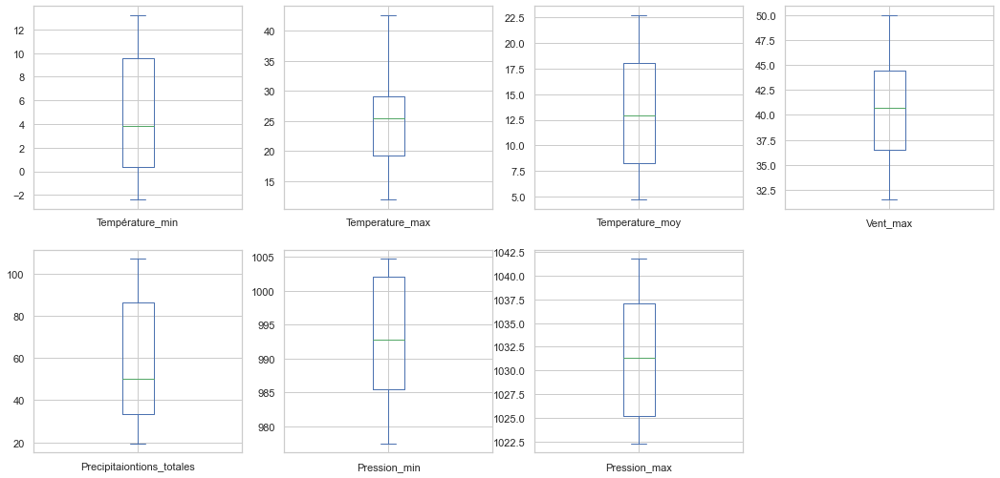

In [184]:
df.plot(kind='box', subplots = True, layout=(4,4), sharex=False, sharey=False, figsize=(18,18))
plt.show()
#Aucun outliers

In [185]:
df.isna().sum()
# Aucune donnée manquante

Température_min              0
Temperature_max              0
Temperature_moy              0
Vent_max                     0
Precipitaiontions_totales    0
Pression_min                 0
Pression_max                 0
dtype: int64

In [186]:
df.duplicated().sum()
#Aucune donnée dupliquée

0

### Analyse univariée

In [187]:
df.describe().round(2)

,Température_min,Temperature_max,Temperature_moy,Vent_max,Precipitaiontions_totales,Pression_min,Pression_max
count,12.00,12.00,12.00,12.00,12.00,12.00,12.00
mean,4.68,25.28,13.24,40.41,58.78,993.28,1031.32
std,5.41,9.06,5.84,5.34,32.18,9.84,6.80
min,-2.40,11.90,4.70,31.50,19.60,977.50,1022.30
25%,0.38,19.30,8.25,36.55,33.40,985.53,1025.20
50%,3.85,25.40,12.90,40.70,50.30,992.80,1031.35
75%,9.60,29.12,18.05,44.40,86.18,1002.10,1037.10
max,13.20,42.60,22.70,50.00,107.00,1004.70,1041.80


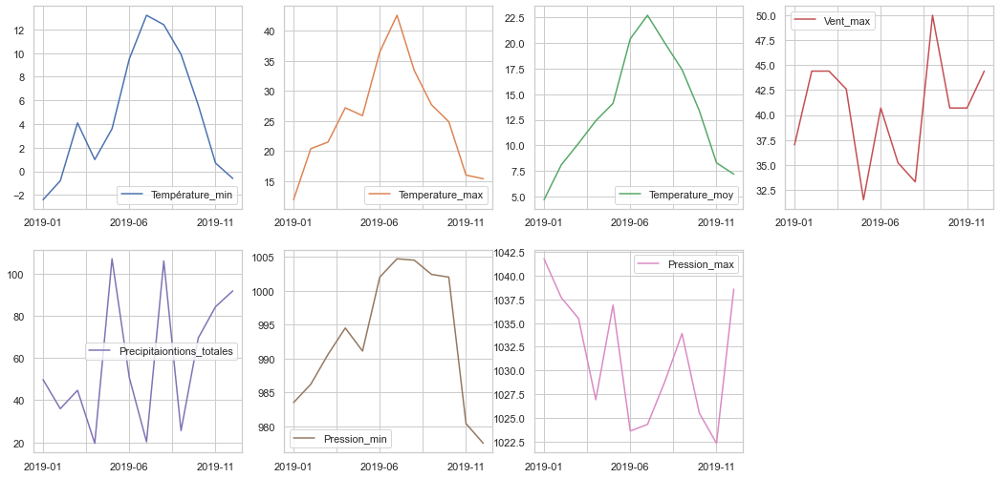

In [188]:
df.plot(subplots = True, layout=(4,4), sharex=False, sharey=False, figsize=(18,18))
plt.show()

<AxesSubplot:title={'center':'Correlation of Numeric Features with y'}>

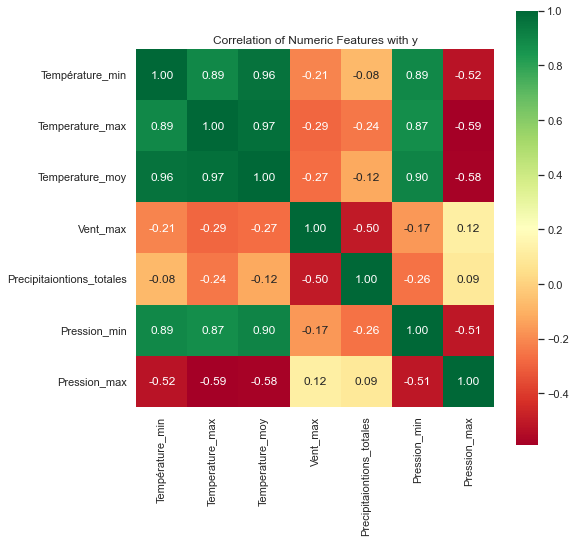

In [189]:
plt.title('Correlation of Numeric Features with y')

rcParams['figure.figsize'] = (8, 8)
sns.heatmap(df.corr(), annot=True,cmap='RdYlGn',square=True, fmt='.2f')

## Analyse multi-source

### création d'un nouveau dataframe avec la moyenne par mois

In [190]:
datadfAll = dataMM.merge(df,left_index=True, right_index=True )

In [191]:
datadfAll.head()

,Pere_Lachaise,Parc_de_Belleville,Bd_Ménilmontant,Stade_Louis_Lumière,Rue_Ménilmontant,Rue_des_Pyrénées,Place_St_Fargeau,Echangeur_A3_BP,Station_Référence_BP_Est,Station_Référence_Paris_18ème,Température_min,Temperature_max,Temperature_moy,Vent_max,Precipitaiontions_totales,Pression_min,Pression_max
2019-01,22.66,18.29,33.80,40.01,47.79,43.43,46.78,56.27,55.28,43.61,-2.4,11.9,4.7,37.0,49.8,983.5,1041.8
2019-02,37.04,43.32,52.96,55.93,63.02,59.31,58.62,71.93,79.65,56.82,-0.8,20.4,8.1,44.4,36.0,986.2,1037.7
2019-03,22.23,23.44,29.11,38.21,42.82,40.16,47.48,54.11,55.11,37.44,4.1,21.5,10.2,44.4,44.7,990.6,1035.5
2019-04,21.52,18.11,31.02,42.51,46.84,40.87,44.57,52.70,73.59,39.09,1.0,27.2,12.4,42.6,19.6,994.5,1026.9
2019-05,19.37,16.22,30.50,33.91,39.63,42.50,43.29,46.84,53.84,31.45,3.6,25.9,14.1,31.5,107.0,991.1,1036.9


In [192]:
Report_datadfAll = ProfileReport(datadfAll, title="Données ministation + métérologique all ", explorative=True)
#Report_datadfAll.to_file("Données ministation + métérologique .html")
Report_datadfAll

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

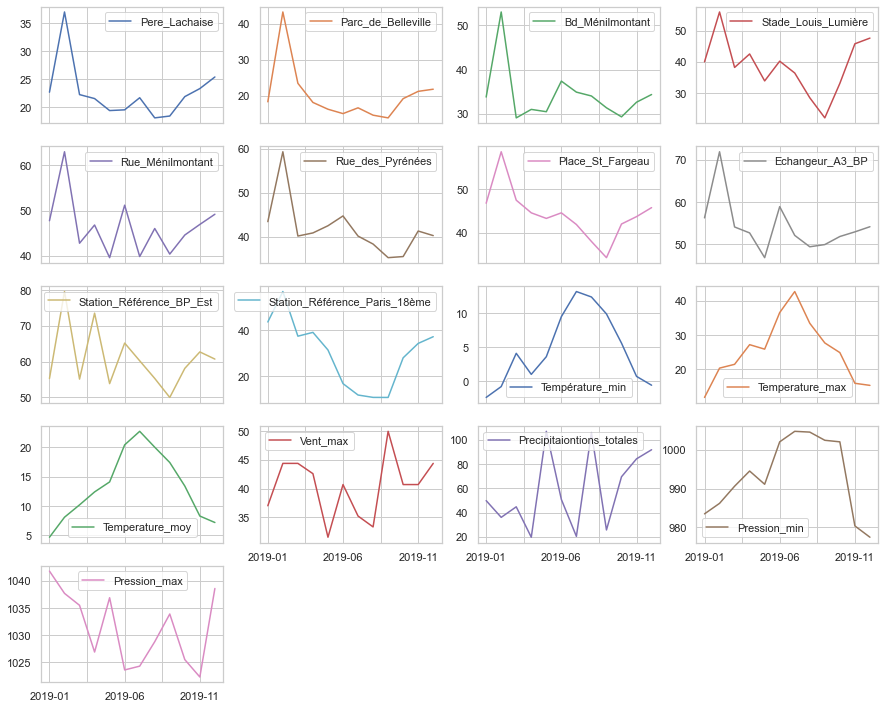

In [193]:
datadfAll.plot(subplots = True, layout=(6,4), sharex=True, sharey=False, figsize=(15,15))
plt.show()

In [194]:
# Correlation linéaire 
DatadfpearsonAll=datadfAll.corr(method='pearson')

<AxesSubplot:title={'center':'Correlation of Numeric Features with y'}>

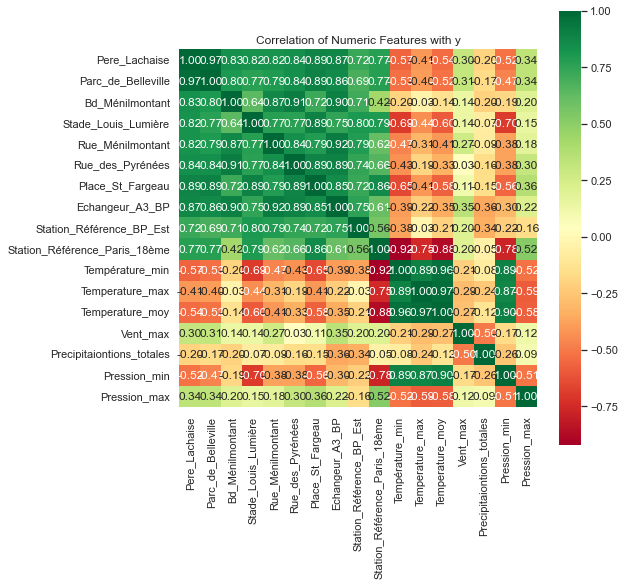

In [195]:
plt.title('Correlation of Numeric Features with y')

rcParams['figure.figsize'] = (8, 8)
sns.heatmap(DatadfpearsonAll, annot=True,cmap='RdYlGn',square=True, fmt='.2f')

In [196]:
#Correlation non linéaire
datadfspearmanAll=datadfAll.corr(method='spearman')

<AxesSubplot:title={'center':'Correlation of Numeric Features with y'}>

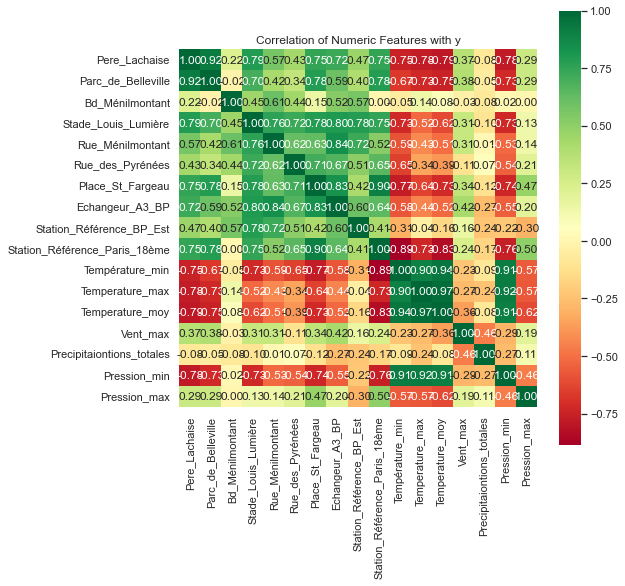

In [197]:
plt.title('Correlation of Numeric Features with y')

rcParams['figure.figsize'] = (8, 8)
sns.heatmap(datadfspearmanAll, annot=True,cmap='RdYlGn',square=True, fmt='.2f')

#### Concentration sur l'action de la météo sur les stations de référence

In [198]:
datadf=datadfAll.copy()

In [199]:
del datadf['Bd_Ménilmontant']
del datadf['Stade_Louis_Lumière']
del datadf['Rue_Ménilmontant']
del datadf['Rue_des_Pyrénées']
del datadf['Place_St_Fargeau'] 
del datadf['Temperature_moy']
del datadf['Pression_min']
del datadf['Pression_max']

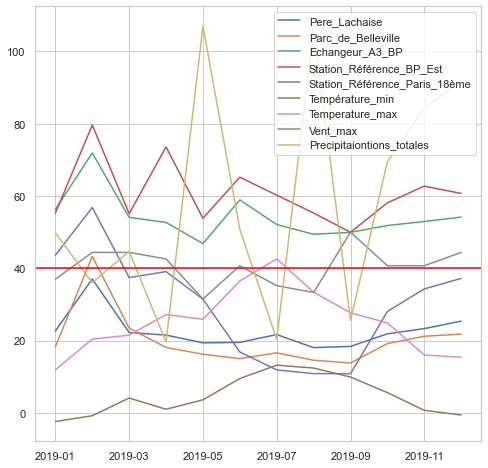

In [200]:
datadf.plot()
plt.axhline(y=40, color='red')

### Création d'un nouveau dataframe avec le maximum par mois

In [201]:
datadfmax = dataIM.merge(df,left_index=True, right_index=True )

In [202]:
datadfmax.head()

,heure_de_la_mesure,Pere_Lachaise,Parc_de_Belleville,Bd_Ménilmontant,Stade_Louis_Lumière,Rue_Ménilmontant,Rue_des_Pyrénées,Place_St_Fargeau,Echangeur_A3_BP,Station_Référence_BP_Est,Station_Référence_Paris_18ème,Température_min,Temperature_max,Temperature_moy,Vent_max,Precipitaiontions_totales,Pression_min,Pression_max
2019-01,23:00:00,60.90,85.84,80.77,74.33,98.01,97.94,81.62,111.13,151.7,108.4,-2.4,11.9,4.7,37.0,49.8,983.5,1041.8
2019-02,23:00:00,113.78,163.74,117.18,103.35,119.72,107.90,98.96,138.49,172.4,134.2,-0.8,20.4,8.1,44.4,36.0,986.2,1037.7
2019-03,23:00:00,101.03,169.96,110.23,102.88,120.05,105.70,99.98,121.57,167.2,134.2,4.1,21.5,10.2,44.4,44.7,990.6,1035.5
2019-04,23:00:00,70.33,154.22,101.86,100.91,99.64,92.59,92.84,108.69,179.6,139.8,1.0,27.2,12.4,42.6,19.6,994.5,1026.9
2019-05,23:00:00,58.71,90.75,97.42,86.49,111.47,99.12,86.47,105.18,149.0,104.4,3.6,25.9,14.1,31.5,107.0,991.1,1036.9


In [203]:
Report_datadfAll = ProfileReport(datadfAll, title="Données ministation + métérologique all ", explorative=True)
#Report_datadfAll.to_file("Données ministation + métérologique .html")
Report_datadfAll

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

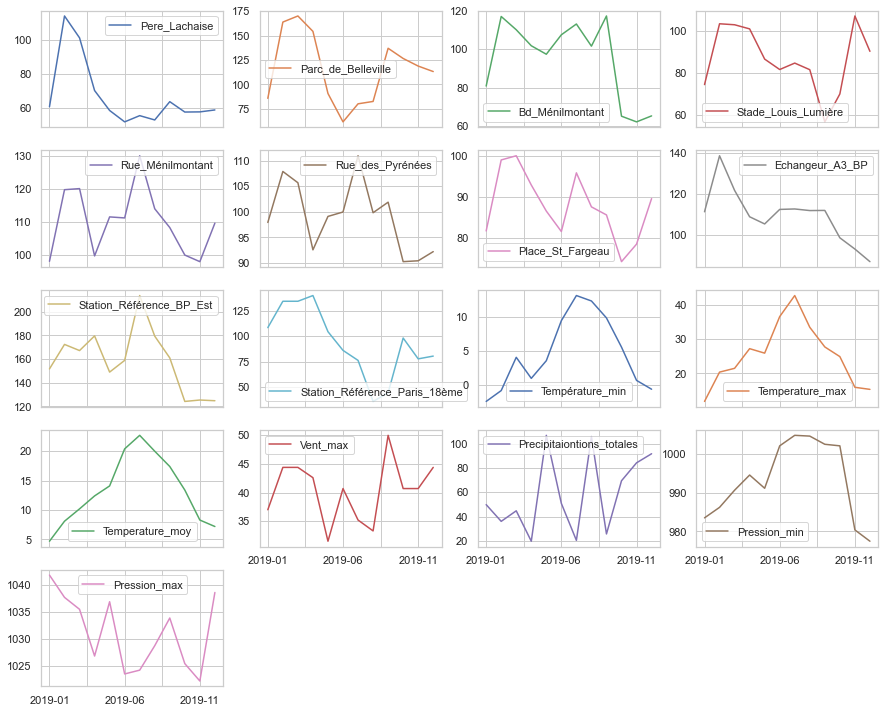

In [204]:
datadfmax.plot(subplots = True, layout=(6,4), sharex=True, sharey=False, figsize=(15,15))
plt.show()

In [205]:
# Correlation linéaire 
Datadfpearson=datadfmax.corr(method='pearson')

<AxesSubplot:title={'center':'Correlation of Numeric Features with y'}>

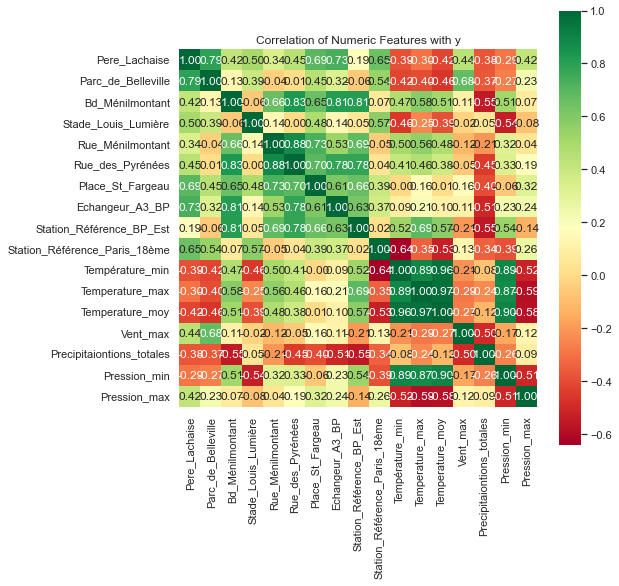

In [206]:
plt.title('Correlation of Numeric Features with y')

rcParams['figure.figsize'] = (8, 8)
sns.heatmap(Datadfpearson, annot=True,cmap='RdYlGn',square=True, fmt='.2f')

In [207]:
#Correlation non linéaire
datadfspearman=datadfmax.corr(method='spearman')

<AxesSubplot:title={'center':'Correlation of Numeric Features with y'}>

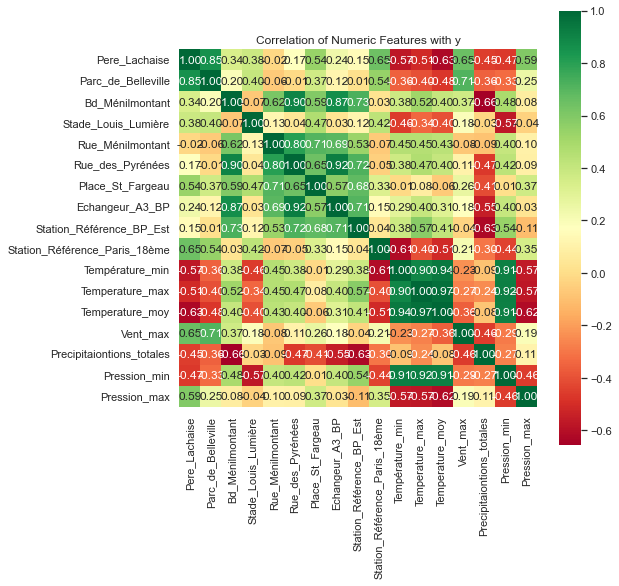

In [208]:
plt.title('Correlation of Numeric Features with y')

rcParams['figure.figsize'] = (8, 8)
sns.heatmap(datadfspearman, annot=True,cmap='RdYlGn',square=True, fmt='.2f')